# Credit Risk Analysis Case Study

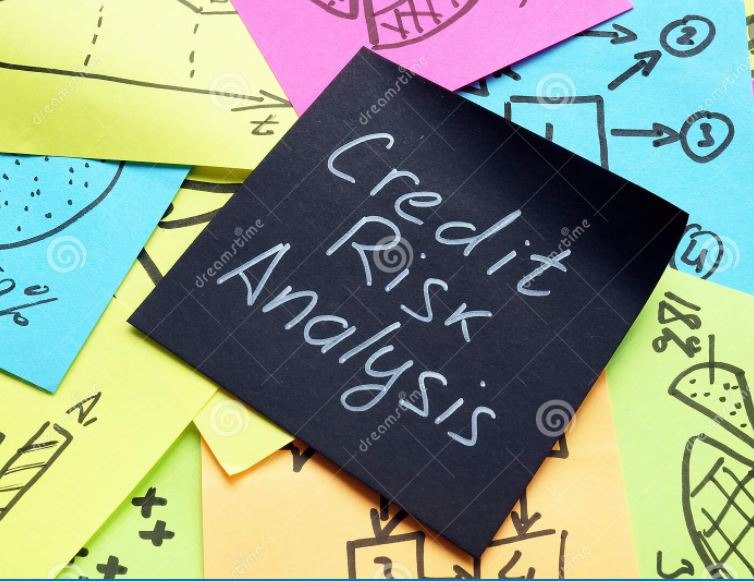

## Problem Statement
Good applicants applied for loan are not rejected and to understand how consumer attributes and loan attributes influence the tendency of default.
To develop a basic understanding of risk analytics in banking and financial services and understand how data is used to minimise the risk of losing money while lending to customers. As part of this study we need to perform below tasks:
1. Data Understanidng,Cleansing and quality check.
2. Univariate and Bi-variate analysis through graphical and statistical analysis.

## Business Objectives
To analyse the patterns in the data to identify patterns which indicate if a client has difficulty paying their installments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. This will ensure that the consumers capable of repaying the loan are not rejected.

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.  The company can utilise this knowledge for its portfolio and risk assessment.

## Dataset Description
The dataset provided contains all the information of the client at the time of application whether a client has payment difficulties or not and it contains the data whether the previous application had been Approved, Cancelled, Refused or Unused offer.


### 1. Import Libraries

In [2]:
# import the necesssary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import pandas_profiling
import scipy.stats

import warnings
warnings.filterwarnings('ignore') #To ignore the warnings

pd.set_option('display.max_columns', 100) # to display all the columns
pd.set_option('display.max_rows', 100) # to display all the rows
pd.set_option('display.width', 1000) # to display width

## 2. Importing Dataset

'application_data'  contains all the information of the client at the time of application.

'previous_application' contains information about the client’s previous loan data.

In [3]:
# Read the csv file from local drive.
New_Application = pd.read_csv(r'application_data.csv')
Previous_Application = pd.read_csv(r'previous_application.csv')

## 2.1 Inspect the New_Application Dataframe
Inspect the dataframe for dimensions, null-values, and summary of different numeric columns.New Application

In [4]:
# take a look at the top 5 rows of the train set, notice the column "Loan_Status"
New_Application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single /

In [5]:
# show the shape of the dataset i.e. no of rows, no of columns
New_Application.shape

(307511, 122)

In [6]:
# concise summary of the dataset, info about index dtype, column dtypes, non-null values and memory usage
New_Application.info(verbose = True, null_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

In [7]:
# To check the summary and descreptive statistics of the columns 
New_Application.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,...,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,...,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,...,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.977752,0.755746,0.044595,0.078078,0.149213,0.225897,0.231625,0.067169,0.101954,0.108607,0.008651,0.028236,0.102547,1.422245,0.143421,1.405292,0.100049,-962.858788,0.000042,0.710023,0.000081,0.015115,0.088055,0.000192

## 2.2 Inspect the Previous Application Dataframe
Inspect the dataframe for dimensions, null-values, and summary of different numeric columns.New Application

In [8]:
Previous_Application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
Previous_Application.shape

(1670214, 37)

In [10]:
Previous_Application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [11]:
Previous_Application.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


## Pandas Profiling before Data Preprocessing

In [12]:
# pre_profile = New_Application.profile_report(title="New Applicants Profile before Data Preprocessing")
# pre_profile.to_widgets()


## 3. Data Analysis

Now that we have loaded the dataset and inspected it, we see that most of the data is in place. As of now, no data cleaning is required, so let's start with some data manipulation, analysis, and visualisation to get various insights about the data. 

### Observations from Pandas Profiling before Data Processing


In [13]:
New_Application.dtypes

SK_ID_CURR                      int64
TARGET                          int64
NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
                               ...   
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_YEAR    float64
Length: 122, dtype: object

## 3.1 Data quality check & Data Cleaning

In [14]:
# Column missing value Percentage
Null_data_percentage = New_Application.isnull().sum()*100/len(New_Application)
Null_data_percentage = Null_data_percentage.sort_values(ascending=False)
len(Null_data_percentage)

122

There are multiple attribute for which the missing value is significant . Let us filter the column value having 
more than 50% missing value. Also , while removing them , we will check for any variable with missing data not at random(MNAR) 
and if that is crateing any bias to the analysis.

In [15]:
#filtering columns where null values and null counts are more than 50%
missing_values = Null_data_percentage[Null_data_percentage >=50]
missing_values

COMMONAREA_MEDI             69.872297
COMMONAREA_AVG              69.872297
COMMONAREA_MODE             69.872297
NONLIVINGAPARTMENTS_MODE    69.432963
NONLIVINGAPARTMENTS_AVG     69.432963
NONLIVINGAPARTMENTS_MEDI    69.432963
FONDKAPREMONT_MODE          68.386172
LIVINGAPARTMENTS_MODE       68.354953
LIVINGAPARTMENTS_AVG        68.354953
LIVINGAPARTMENTS_MEDI       68.354953
FLOORSMIN_AVG               67.848630
FLOORSMIN_MODE              67.848630
FLOORSMIN_MEDI              67.848630
YEARS_BUILD_MEDI            66.497784
YEARS_BUILD_MODE            66.497784
YEARS_BUILD_AVG             66.497784
OWN_CAR_AGE                 65.990810
LANDAREA_MEDI               59.376738
LANDAREA_MODE               59.376738
LANDAREA_AVG                59.376738
BASEMENTAREA_MEDI           58.515956
BASEMENTAREA_AVG            58.515956
BASEMENTAREA_MODE           58.515956
EXT_SOURCE_1                56.381073
NONLIVINGAREA_MODE          55.179164
NONLIVINGAREA_AVG           55.179164
NONLIVINGARE

## 3.2 Finding missing values above 50%

In [16]:
# number of columns having more than 50% of null values
len(missing_values)

41

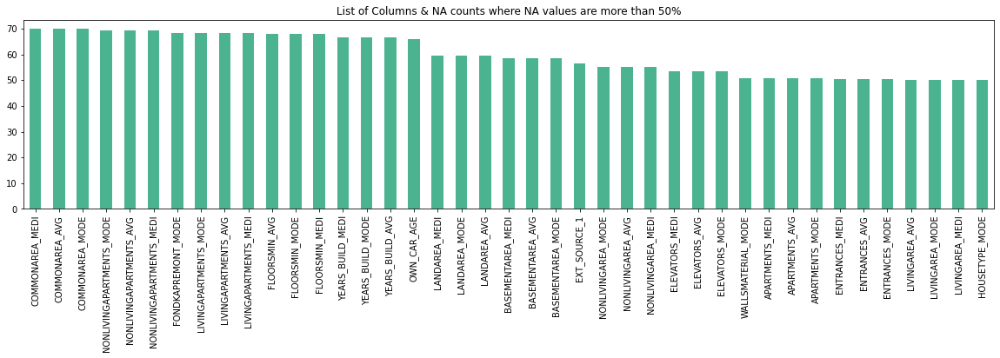

In [17]:
# List of columns where NA Columns are more than 0.5%
plt.figure(figsize=(20,4))
missing_values.plot(kind='bar', color="#4CB391")
plt.title('List of Columns & NA counts where NA values are more than 50%')
plt.show()

In [18]:
# Comparision of shape of new and old data sets
NewApplication = New_Application.loc[:,New_Application.isnull().mean()<=0.50]
print('Number of Columns Dropped:\t', len(missing_values))
print('Old dataset dimension:', New_Application.shape)
print('New dataset dimension:' , NewApplication.shape)

Number of Columns Dropped:	 41
Old dataset dimension: (307511, 122)
New dataset dimension: (307511, 81)


## 3.3 Checking the % of null values for each column in new dataset



In [19]:
# Checking the % of null values for each column in new dataset
null_values = NewApplication.isnull().sum()/len(NewApplication)*100
null_values.sort_values(ascending = False)

FLOORSMAX_AVG                   49.760822
FLOORSMAX_MODE                  49.760822
FLOORSMAX_MEDI                  49.760822
YEARS_BEGINEXPLUATATION_AVG     48.781019
YEARS_BEGINEXPLUATATION_MODE    48.781019
YEARS_BEGINEXPLUATATION_MEDI    48.781019
TOTALAREA_MODE                  48.268517
EMERGENCYSTATE_MODE             47.398304
OCCUPATION_TYPE                 31.345545
EXT_SOURCE_3                    19.825307
AMT_REQ_CREDIT_BUREAU_YEAR      13.501631
AMT_REQ_CREDIT_BUREAU_HOUR      13.501631
AMT_REQ_CREDIT_BUREAU_DAY       13.501631
AMT_REQ_CREDIT_BUREAU_WEEK      13.501631
AMT_REQ_CREDIT_BUREAU_MON       13.501631
AMT_REQ_CREDIT_BUREAU_QRT       13.501631
NAME_TYPE_SUITE                  0.420148
DEF_30_CNT_SOCIAL_CIRCLE         0.332021
OBS_60_CNT_SOCIAL_CIRCLE         0.332021
DEF_60_CNT_SOCIAL_CIRCLE         0.332021
OBS_30_CNT_SOCIAL_CIRCLE         0.332021
EXT_SOURCE_2                     0.214626
AMT_GOODS_PRICE                  0.090403
AMT_ANNUITY                      0

In [20]:
NewApplication.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 81 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    307511 non-null  int64  
 1   TARGET                        307511 non-null  int64  
 2   NAME_CONTRACT_TYPE            307511 non-null  object 
 3   CODE_GENDER                   307511 non-null  object 
 4   FLAG_OWN_CAR                  307511 non-null  object 
 5   FLAG_OWN_REALTY               307511 non-null  object 
 6   CNT_CHILDREN                  307511 non-null  int64  
 7   AMT_INCOME_TOTAL              307511 non-null  float64
 8   AMT_CREDIT                    307511 non-null  float64
 9   AMT_ANNUITY                   307499 non-null  float64
 10  AMT_GOODS_PRICE               307233 non-null  float64
 11  NAME_TYPE_SUITE               306219 non-null  object 
 12  NAME_INCOME_TYPE              307511 non-nul

## 4. Data quality check & Missing value treatment

### 4.1 Imputing missing values in columns

#### Imputing columns with 'mode' value as they all are number of credit inquiries, replacing missing values with the most frequent value would make more sense inclucing ' occupation_type'.

In [21]:
NewApplication[['OCCUPATION_TYPE','AMT_REQ_CREDIT_BUREAU_YEAR', 
                'AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_DAY', 
                'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_QRT']].value_counts()

OCCUPATION_TYPE       AMT_REQ_CREDIT_BUREAU_YEAR  AMT_REQ_CREDIT_BUREAU_MON  AMT_REQ_CREDIT_BUREAU_WEEK  AMT_REQ_CREDIT_BUREAU_DAY  AMT_REQ_CREDIT_BUREAU_HOUR  AMT_REQ_CREDIT_BUREAU_QRT
Laborers              0.0                         0.0                        0.0                         0.0                        0.0                         0.0                          8548
                      1.0                         0.0                        0.0                         0.0                        0.0                         0.0                          7387
                      2.0                         0.0                        0.0                         0.0                        0.0                         0.0                          5832
Core staff            0.0                         0.0                        0.0                         0.0                        0.0                         0.0                          5394
Sales staff           0.0             

In [22]:
NewApplication[['OCCUPATION_TYPE','AMT_REQ_CREDIT_BUREAU_YEAR', 
                'AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_DAY', 
                'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_QRT']].mode()

,OCCUPATION_TYPE,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_QRT
0,Laborers,0.0,0.0,0.0,0.0,0.0,0.0


### 4.2 For the column 'AMT_GOODS_PRICE' & 'AMT_ANNUITY' we can impute the missing values with the median,

In [23]:
NewApplication[['AMT_GOODS_PRICE','AMT_ANNUITY',]].value_counts()

AMT_GOODS_PRICE  AMT_ANNUITY
180000.0         9000.0         6280
270000.0         13500.0        5384
135000.0         6750.0         2194
202500.0         10125.0        1980
1125000.0        37800.0        1596
                                ... 
463500.0         18166.5           1
                 17653.5           1
                 17446.5           1
                 17176.5           1
4050000.0        258025.5          1
Length: 41949, dtype: int64

In [24]:
NewApplication[['AMT_GOODS_PRICE','AMT_ANNUITY',]].median()

AMT_GOODS_PRICE    450000.0
AMT_ANNUITY         24903.0
dtype: float64

### 4.3 Errors in Datatypes

In [25]:
NewApplication.isnull().sum()/len(NewApplication)*100

SK_ID_CURR                       0.000000
TARGET                           0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0.000000
FLAG_OWN_CAR                     0.000000
FLAG_OWN_REALTY                  0.000000
CNT_CHILDREN                     0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
AMT_ANNUITY                      0.003902
AMT_GOODS_PRICE                  0.090403
NAME_TYPE_SUITE                  0.420148
NAME_INCOME_TYPE                 0.000000
NAME_EDUCATION_TYPE              0.000000
NAME_FAMILY_STATUS               0.000000
NAME_HOUSING_TYPE                0.000000
REGION_POPULATION_RELATIVE       0.000000
DAYS_BIRTH                       0.000000
DAYS_EMPLOYED                    0.000000
DAYS_REGISTRATION                0.000000
DAYS_ID_PUBLISH                  0.000000
FLAG_MOBIL                       0.000000
FLAG_EMP_PHONE                   0.000000
FLAG_WORK_PHONE                  0

In [26]:
NewApplication.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'YEARS_BEGINEXPLUATATION_AVG', 'FLOORSMAX_AVG', 'YEARS_BEGINEXPLUATATION_MODE', 'FLOORSMAX_MODE', 'YEARS_BEGINEXPLUATATION_MEDI',
     

In [27]:
# we found these columns unwanted or not required so we will drop them for further analysis
unwanted = ['FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE','FLAG_EMAIL',
          'REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY', 'FLAG_EMAIL','DAYS_LAST_PHONE_CHANGE',
          'FLAG_DOCUMENT_2','REG_REGION_NOT_LIVE_REGION','REG_REGION_NOT_WORK_REGION',
          'LIVE_REGION_NOT_WORK_REGION','FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4','FLAG_DOCUMENT_5',
          'FLAG_DOCUMENT_6','FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10',
          'FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14',
          'FLAG_DOCUMENT_15','FLAG_DOCUMENT_16','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18',
          'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']

NewApplication.drop(columns=unwanted, inplace=True)



In [28]:
# New dataset shape
NewApplication.shape

(307511, 50)

## 5.1 Now, we got the final dataframe after dropping unwanted columns.
### We can check for dtypes of each columns and change their dtype based on the values

In [29]:
NewApplication.nunique().sort_values()

REG_CITY_NOT_WORK_CITY               2
TARGET                               2
NAME_CONTRACT_TYPE                   2
FLAG_OWN_CAR                         2
FLAG_OWN_REALTY                      2
FLAG_MOBIL                           2
LIVE_CITY_NOT_WORK_CITY              2
EMERGENCYSTATE_MODE                  2
REG_CITY_NOT_LIVE_CITY               2
CODE_GENDER                          3
NAME_EDUCATION_TYPE                  5
AMT_REQ_CREDIT_BUREAU_HOUR           5
NAME_HOUSING_TYPE                    6
NAME_FAMILY_STATUS                   6
NAME_TYPE_SUITE                      7
WEEKDAY_APPR_PROCESS_START           7
NAME_INCOME_TYPE                     8
DEF_60_CNT_SOCIAL_CIRCLE             9
AMT_REQ_CREDIT_BUREAU_WEEK           9
AMT_REQ_CREDIT_BUREAU_DAY            9
DEF_30_CNT_SOCIAL_CIRCLE            10
AMT_REQ_CREDIT_BUREAU_QRT           11
CNT_CHILDREN                        15
CNT_FAM_MEMBERS                     17
OCCUPATION_TYPE                     18
AMT_REQ_CREDIT_BUREAU_MON

In [30]:
NewApplication.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 50 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    307511 non-null  int64  
 1   TARGET                        307511 non-null  int64  
 2   NAME_CONTRACT_TYPE            307511 non-null  object 
 3   CODE_GENDER                   307511 non-null  object 
 4   FLAG_OWN_CAR                  307511 non-null  object 
 5   FLAG_OWN_REALTY               307511 non-null  object 
 6   CNT_CHILDREN                  307511 non-null  int64  
 7   AMT_INCOME_TOTAL              307511 non-null  float64
 8   AMT_CREDIT                    307511 non-null  float64
 9   AMT_ANNUITY                   307499 non-null  float64
 10  AMT_GOODS_PRICE               307233 non-null  float64
 11  NAME_TYPE_SUITE               306219 non-null  object 
 12  NAME_INCOME_TYPE              307511 non-nul

In [31]:
# we notice that till variable ORGANIZATION_TYPE all variables are categorical
# so we will get their index and convert them to categorical columns
NewApplication.nunique().sort_values().index

Index(['REG_CITY_NOT_WORK_CITY', 'TARGET', 'NAME_CONTRACT_TYPE', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'FLAG_MOBIL', 'LIVE_CITY_NOT_WORK_CITY', 'EMERGENCYSTATE_MODE', 'REG_CITY_NOT_LIVE_CITY', 'CODE_GENDER', 'NAME_EDUCATION_TYPE', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'NAME_HOUSING_TYPE', 'NAME_FAMILY_STATUS', 'NAME_TYPE_SUITE', 'WEEKDAY_APPR_PROCESS_START', 'NAME_INCOME_TYPE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_DAY', 'DEF_30_CNT_SOCIAL_CIRCLE', 'AMT_REQ_CREDIT_BUREAU_QRT', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'OCCUPATION_TYPE', 'AMT_REQ_CREDIT_BUREAU_MON', 'HOUR_APPR_PROCESS_START', 'FLOORSMAX_MODE', 'AMT_REQ_CREDIT_BUREAU_YEAR', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'FLOORSMAX_MEDI', 'ORGANIZATION_TYPE', 'REGION_POPULATION_RELATIVE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BEGINEXPLUATATION_AVG', 'FLOORSMAX_AVG', 'EXT_SOURCE_3', 'AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL', 'TOTALAREA_MODE', 'AMT_CREDIT',
    

In [32]:
categorical_cols = ['FLAG_MOBIL', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
                    'FLAG_OWN_REALTY', 'REG_CITY_NOT_WORK_CITY','LIVE_CITY_NOT_WORK_CITY',
                    'REG_CITY_NOT_LIVE_CITY','AMT_REQ_CREDIT_BUREAU_HOUR', 'NAME_EDUCATION_TYPE',
                    'NAME_HOUSING_TYPE', 'NAME_FAMILY_STATUS', 'WEEKDAY_APPR_PROCESS_START',
                    'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'AMT_REQ_CREDIT_BUREAU_DAY',
                    'AMT_REQ_CREDIT_BUREAU_WEEK', 'DEF_60_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE',
                    'AMT_REQ_CREDIT_BUREAU_QRT', 'CNT_CHILDREN','CNT_FAM_MEMBERS','OCCUPATION_TYPE',
                    'HOUR_APPR_PROCESS_START','AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_YEAR',
                    'OBS_60_CNT_SOCIAL_CIRCLE','OBS_30_CNT_SOCIAL_CIRCLE','ORGANIZATION_TYPE']
for col in categorical_cols:
    NewApplication[col] = NewApplication[col].astype('category')

In [33]:
# SK_ID_CURR is int data type, but it holds id number of customers, and this variable cannot be manipulated
# so we will convert it to object datatype
NewApplication['SK_ID_CURR'] = NewApplication['SK_ID_CURR'].astype('object')

In [34]:
# we will check the dtypes again to confirm
NewApplication.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 50 columns):
 #   Column                        Non-Null Count   Dtype   
---  ------                        --------------   -----   
 0   SK_ID_CURR                    307511 non-null  object  
 1   TARGET                        307511 non-null  category
 2   NAME_CONTRACT_TYPE            307511 non-null  category
 3   CODE_GENDER                   307511 non-null  category
 4   FLAG_OWN_CAR                  307511 non-null  category
 5   FLAG_OWN_REALTY               307511 non-null  category
 6   CNT_CHILDREN                  307511 non-null  category
 7   AMT_INCOME_TOTAL              307511 non-null  float64 
 8   AMT_CREDIT                    307511 non-null  float64 
 9   AMT_ANNUITY                   307499 non-null  float64 
 10  AMT_GOODS_PRICE               307233 non-null  float64 
 11  NAME_TYPE_SUITE               306219 non-null  category
 12  NAME_INCOME_TYPE              

In [35]:
#we notice that "DAYS_BIRTH"  'DAYS_EMPLOYED' 'DAYS_REGISTRATION' 'DAYS_ID_PUBLISH' columns have negative values,which is not not possible.
# so we will try to correct this
NewApplication[['DAYS_BIRTH' ,'DAYS_EMPLOYED' ,'DAYS_REGISTRATION' ,'DAYS_ID_PUBLISH']]

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH
0,-9461,-637,-3648.0,-2120
1,-16765,-1188,-1186.0,-291
2,-19046,-225,-4260.0,-2531
3,-19005,-3039,-9833.0,-2437
4,-19932,-3038,-4311.0,-3458
...,...,...,...,...
307506,-9327,-236,-8456.0,-1982
307507,-20775,365243,-4388.0,-4090
307508,-14966,-7921,-6737.0,-5150
307509,-11961,-4786,-2562.0,-931


## 5.2 Changing negative columns to absolute

In [36]:
'''we will now convert negative values to positve values using abs() 
and then convert days into years for better understanding'''

days_cols = ['DAYS_BIRTH' ,'DAYS_EMPLOYED' ,'DAYS_REGISTRATION' ,'DAYS_ID_PUBLISH']
NewApplication[days_cols] = NewApplication[days_cols].abs()
NewApplication[days_cols] = (NewApplication[days_cols]/365).astype(int)
NewApplication[days_cols].describe()

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH
count,307511.000000,307511.000000,307511.000000,307511.000000
mean,43.435968,185.021521,13.168683,7.713474
std,11.954593,381.972190,9.646841,4.134515
min,20.000000,0.000000,0.000000,0.000000
25%,34.000000,2.000000,5.000000,4.000000
50%,43.000000,6.000000,12.000000,8.000000
75%,53.000000,15.000000,20.000000,11.000000
max,69.000000,1000.000000,67.000000,19.000000


In [37]:
# Days converted into years
NewApplication[['DAYS_BIRTH' ,'DAYS_EMPLOYED' ,'DAYS_REGISTRATION' ,'DAYS_ID_PUBLISH']]

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH
0,25,1,9,5
1,45,3,3,0
2,52,0,11,6
3,52,8,26,6
4,54,8,11,9
...,...,...,...,...
307506,25,0,23,5
307507,56,1000,12,11
307508,41,21,18,14
307509,32,13,7,2


In [38]:
NewApplication['DAYS_BIRTH'].unique()

array([25, 45, 52, 54, 46, 37, 51, 55, 39, 27, 36, 38, 23, 35, 26, 48, 31,
       50, 40, 30, 68, 43, 28, 41, 32, 33, 47, 57, 65, 44, 64, 21, 59, 49,
       56, 62, 53, 42, 29, 67, 63, 61, 58, 60, 34, 22, 24, 66, 69, 20])

### 5.3 Checking the object datatype variables

In [39]:
# we will now check gendere column
NewApplication['CODE_GENDER'].value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [40]:
# Gender varible contains categorical value, so we will replace XNA with F based on mode value
# NewApplication.loc[NewApplication['CODE_GENDER']=='XNA', 'CODE_GENDER'] = 'F'
# NewApplication['CODE_GENDER'].value_counts()
NewApplication.loc[NewApplication['CODE_GENDER']=='XNA','CODE_GENDER']='F'
NewApplication['CODE_GENDER'].value_counts()

F      202452
M      105059
XNA         0
Name: CODE_GENDER, dtype: int64

In [41]:
# Removing the column values of 'XNA' and 'XAP'
NewApplication=NewApplication.drop(NewApplication[NewApplication['CODE_GENDER']=='XNA'].index)

In [42]:
NewApplication.ORGANIZATION_TYPE.value_counts()

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

#### So, for column 'ORGANIZATION_TYPE', we have total count of 307511 rows of which 55374 rows are having 'XNA' values. Which means 18% of the column is having this values. Hence if we drop the rows of total 55374, will not have any major impact on our dataset.

In [43]:
# Hence, dropping the rows of total 55374 have 'XNA' values in the organization type column

NewApplication=NewApplication.drop(NewApplication.loc[NewApplication['ORGANIZATION_TYPE']=='XNA'].index)
NewApplication[NewApplication['ORGANIZATION_TYPE']=='XNA'].shape

(0, 50)

In [44]:
NewApplication['ORGANIZATION_TYPE'].value_counts()

Business Entity Type 3    67992
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transport: type 3          1187
Industry

## 6. Binning of continuous variables

In [45]:
# Binning 'AMT_INCOME_RANGE' based on quantiles
NewApplication['AMT_INCOME_RANGE'] = pd.qcut(NewApplication.AMT_INCOME_TOTAL, q=[0, 0.2, 0.5, 0.8, 0.95, 1],
                                             labels=['VERY_LOW', 'LOW', "MEDIUM", 'HIGH', 'VERY_HIGH'])
NewApplication['AMT_INCOME_RANGE'].head(11)

0        MEDIUM
1          HIGH
2      VERY_LOW
3           LOW
4           LOW
5      VERY_LOW
6        MEDIUM
7     VERY_HIGH
9           LOW
10     VERY_LOW
12     VERY_LOW
Name: AMT_INCOME_RANGE, dtype: category
Categories (5, object): ['VERY_LOW' < 'LOW' < 'MEDIUM' < 'HIGH' < 'VERY_HIGH']

In [46]:
# Binning 'AMT_CREDIT_RANGE' by creating various ranges
NewApplication['AMT_CREDIT_RANGE'] = pd.qcut(NewApplication.AMT_CREDIT, q=[0, 0.2, 0.5, 0.8, 0.95, 1], 
                                      labels=['VERY_LOW', 'LOW', "MEDIUM", 'HIGH', 'VERY_HIGH'])
NewApplication['AMT_CREDIT_RANGE'].head(11)

0           LOW
1          HIGH
2      VERY_LOW
3           LOW
4           LOW
5           LOW
6     VERY_HIGH
7     VERY_HIGH
9           LOW
10       MEDIUM
12     VERY_LOW
Name: AMT_CREDIT_RANGE, dtype: category
Categories (5, object): ['VERY_LOW' < 'LOW' < 'MEDIUM' < 'HIGH' < 'VERY_HIGH']

In [47]:
NewApplication= NewApplication.replace('XNA',np.NaN)

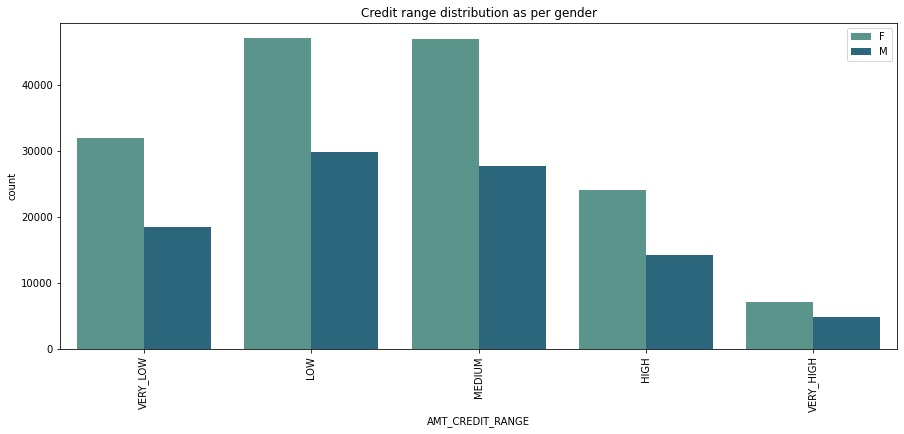

In [48]:
plt.figure(figsize=(15,6)) 
sns.countplot(data=NewApplication,x='AMT_CREDIT_RANGE', hue='CODE_GENDER',palette="crest")
plt.title("Credit range distribution as per gender")
plt.xticks(rotation=90)
plt.legend(loc='upper right')
plt.show()

### Points to be concluded from the above graph.

1. Female counts are higher than male.
2. Very low range to medium range have more number of credits.
3. This graph show that females are more than male in having credits for that range.
4. Very less count of income above medium range and above.

In [49]:
# Biining 'DAYS_BIRTH'
NewApplication['DAYS_BIRTH_BINS']=pd.cut(NewApplication['DAYS_BIRTH'], 
                                         bins=[19,25,35,60,100], 
                                         labels=['Very_Young','Young', 'Middle_Age', 'Senior_Citizen'])

In [50]:
NewApplication['DAYS_BIRTH_BINS'].value_counts()

Middle_Age        155746
Young              75643
Very_Young         16267
Senior_Citizen      4481
Name: DAYS_BIRTH_BINS, dtype: int64

## 7. Analysis

### 7.1 Finding Outliers

In [51]:
# boxplot for 'AMT_INCOME_TOTAL' column to check the outliers
fig = px.box(NewApplication, y="AMT_INCOME_TOTAL", title='Distribution of AMT_INCOME_TOTAL')
fig.show()

#### Here, in  'AMT_INCOME_TOTAL' depicts the income of the client. We observe a value of 117M which is surely an outlier.

In [52]:
NewApplication['DAYS_EMPLOYED'].unique()

array([ 1,  3,  0,  8,  4,  5,  7, 21, 11,  2,  9, 12, 14, 26, 19,  6, 10,
       13, 24, 18, 23, 15, 22, 27, 32, 20, 25, 42, 16, 30, 38, 33, 17, 31,
       28, 29, 36, 34, 40, 39, 35, 37, 41, 44, 43, 48, 46, 45, 47, 49])

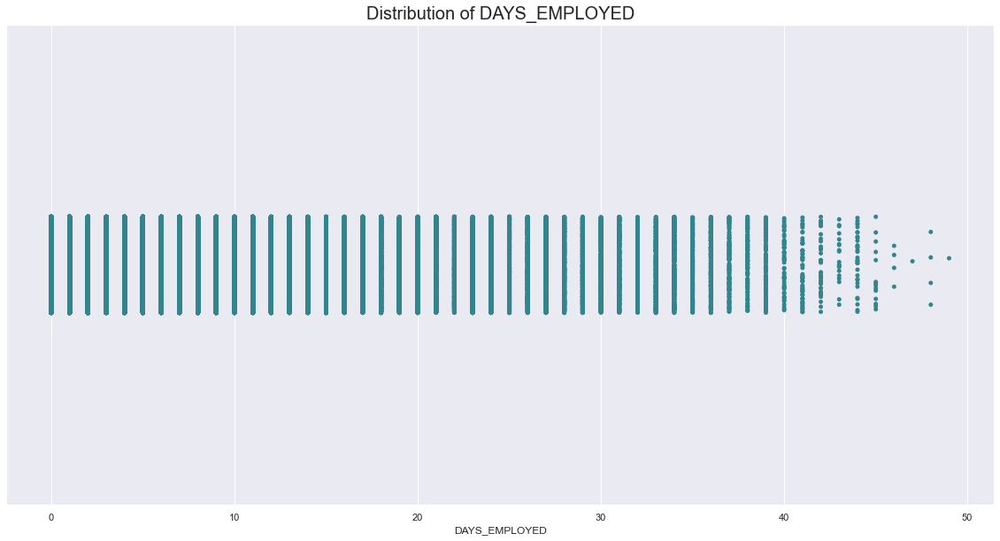

In [53]:
# distribution of 'DAYS_EMPLOYED'
sns.set(rc={'figure.figsize':(20,10)})
sns.stripplot(NewApplication['DAYS_EMPLOYED'], orient='v', palette="crest")
plt.title('Distribution of DAYS_EMPLOYED', fontdict={'fontsize':20} )
plt.show()

#### Here, in the coloumn 'DAYS_EMPLOYED' which is converted into years tells when client change the the registration. We observe a values which are close to 50 years. Considering that a person started working at age of 21, the person will be 21+50 will turn out to be 71 years old.

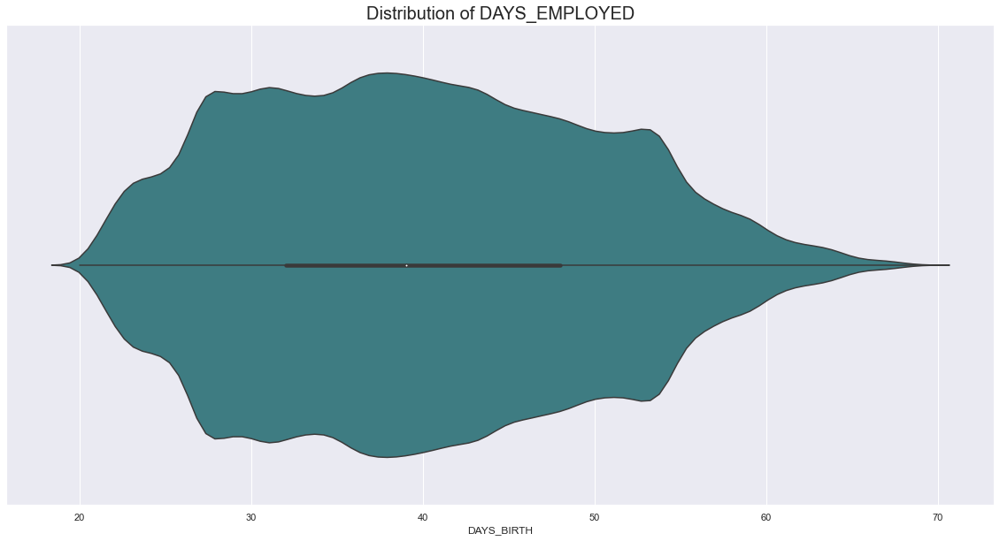

In [54]:
fig = px.box(NewApplication, y="DAYS_BIRTH",title='Distribution of DAYS_BIRTH' )
fig.show()
# distribution of 'DAYS_EMPLOYED' using Violinplot
sns.set(rc={'figure.figsize':(20,10)})
sns.violinplot(NewApplication['DAYS_BIRTH'], orient='v', palette="crest")
plt.title('Distribution of DAYS_EMPLOYED', fontdict={'fontsize':20} )
plt.show()

#### We do not find any outliers in the coloumn 'DAYS_BIRTH' using both violin and boxplot

In [55]:
fig = px.box(NewApplication, y="AMT_ANNUITY",title='Distribution of AMT_ANNUITY' )
fig.show()

#### Column 'AMT_AANNUITY' depicts the loan annuity, where a value which is greater that 258000 which is surely an outlier.

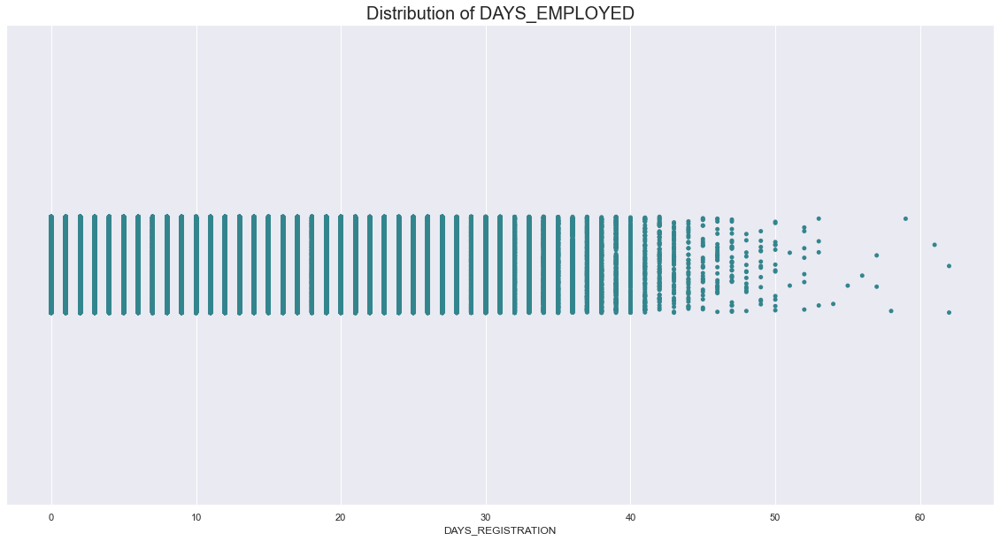

In [56]:
# fig = px.box(NewApplication, y="DAYS_REGISTRATION", title='Distribution of DAYS_REGISTRATION' )
# fig.show()
sns.set(rc={'figure.figsize':(20,10)})
sns.stripplot(NewApplication['DAYS_REGISTRATION'], orient='v', palette="crest")
plt.title('Distribution of DAYS_EMPLOYED', fontdict={'fontsize':20} )
plt.show()

#### In above column 'DAYS_REGISTRATION' which how many days before the application did client change his registration. We observe a value which is greater that 60 which is surely an outlier.



### 7.2 Checking the distribution

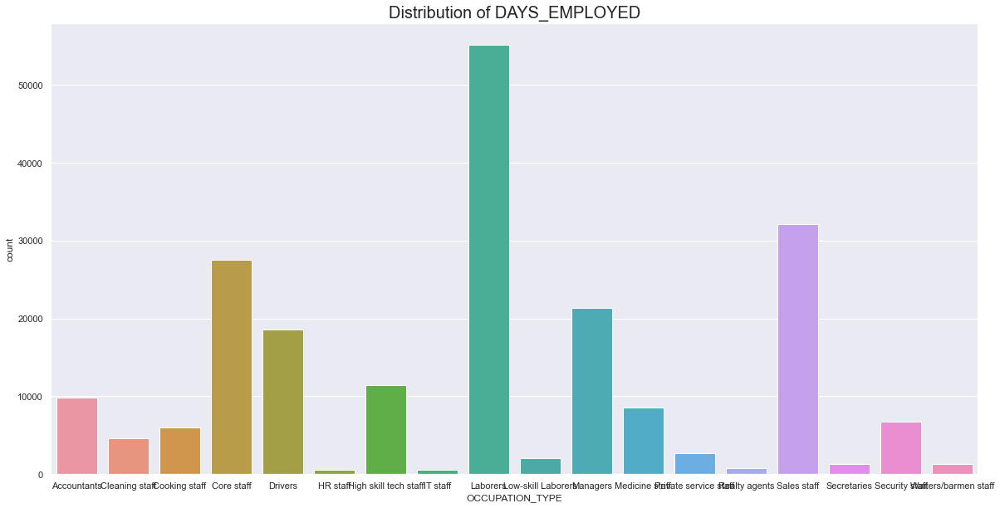

In [57]:
# Distribution of 'OCCUPATION_TYPE'
sns.set(rc={'figure.figsize':(20,10)})
sns.countplot(NewApplication['OCCUPATION_TYPE'].sort_values())
plt.title('Distribution of DAYS_EMPLOYED', fontdict={'fontsize':20} )
plt.show()

#### We can observer that Labourers, Sales Staff and Core Staff constitute the majority whereas IT Staff is on the lower side.



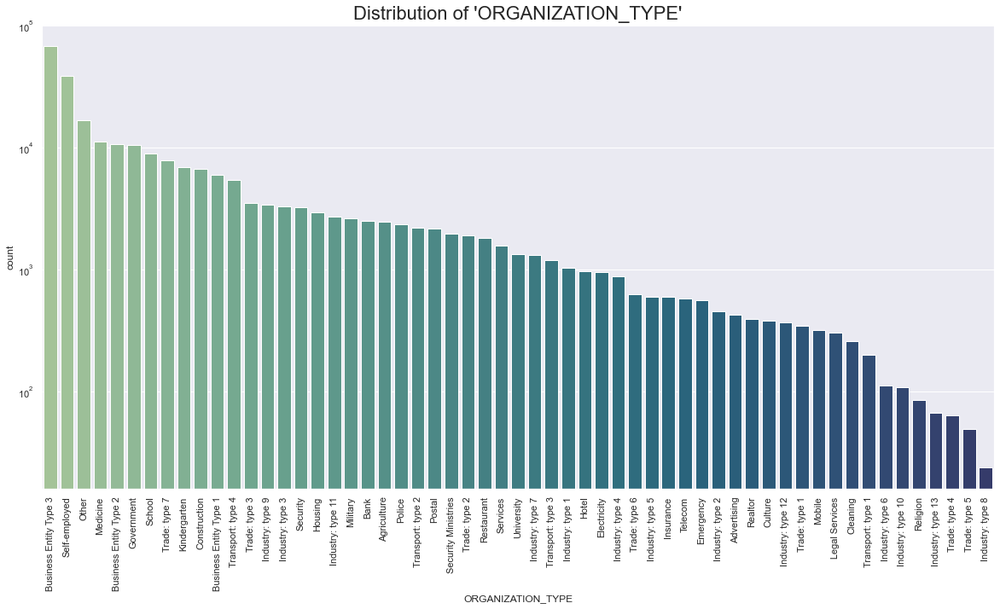

In [58]:
# Distribution of 'ORGANIZATION_TYPE'
plt.rcParams['axes.titlesize'] = 22
plt.xticks(rotation=90)
plt.yscale('log')
plt.title("Distribution of 'ORGANIZATION_TYPE'")
sns.countplot(data = NewApplication, x=col, 
              order=NewApplication['ORGANIZATION_TYPE'].value_counts().index, palette='crest') 
        
plt.show()

#### Here, we can clearly see that Business Entity Type 3 organizations have majority of the loan applications.

### 7.3 Checking the Imbalance

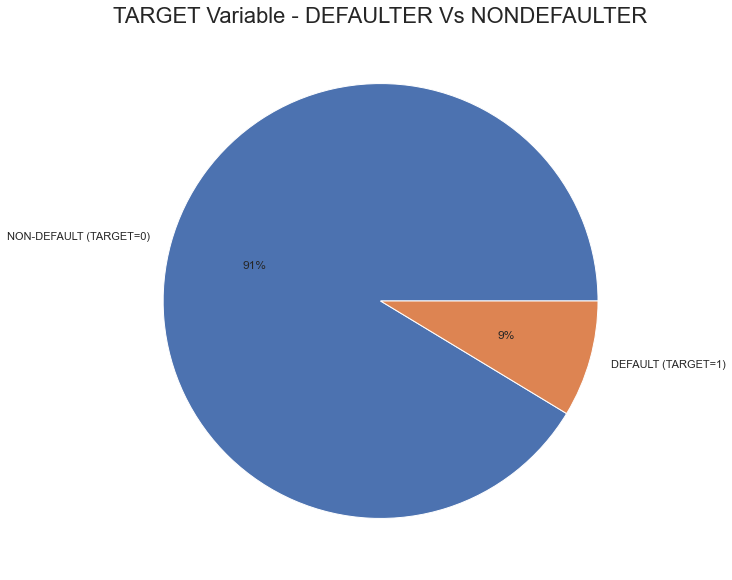

In [59]:
plt.pie(NewApplication['TARGET'].value_counts(normalize=True)*100,labels=['NON-DEFAULT (TARGET=0)','DEFAULT (TARGET=1)'],autopct='%1.f%%')
plt.title('TARGET Variable - DEFAULTER Vs NONDEFAULTER')
plt.show()

### 7.4 Dividing the dataset into two different datasets based upon 'Target' value.


In [60]:
# Dividing the original dataset into two different datasets depending upon the target value
target0 = NewApplication.loc[NewApplication.TARGET == 0]
target1 = NewApplication.loc[NewApplication.TARGET == 1]

## 8. Univariate Analysis of Categorical Variables


### 8.1 For both Target0 & Target1

In [61]:
# Count plotting in logarithmic scale

def uniplot(df,col,title,hue =None):
    
    sns.set_style('whitegrid')
    sns.set_context('talk')
    plt.rcParams["axes.labelsize"] = 20
    plt.rcParams['axes.titlesize'] = 22
    plt.rcParams['axes.titlepad'] = 30
    
    
    temp = pd.Series(data = hue)
    fig, ax = plt.subplots()
    width = len(df[col].unique()) + 7 + 4*len(temp.unique())
    fig.set_size_inches(width , 8)
    plt.xticks(rotation=90)
    plt.yscale('log')
    plt.title(title)
    ax = sns.countplot(data = df, x= col, order=df[col].value_counts().index,hue = hue,palette='crest') 
        
    plt.show()

In [62]:
# Replacing "XNA" with NaN values
target0= target0.replace('XNA',np.NaN)
target1= target1.replace('XNA',np.NaN)

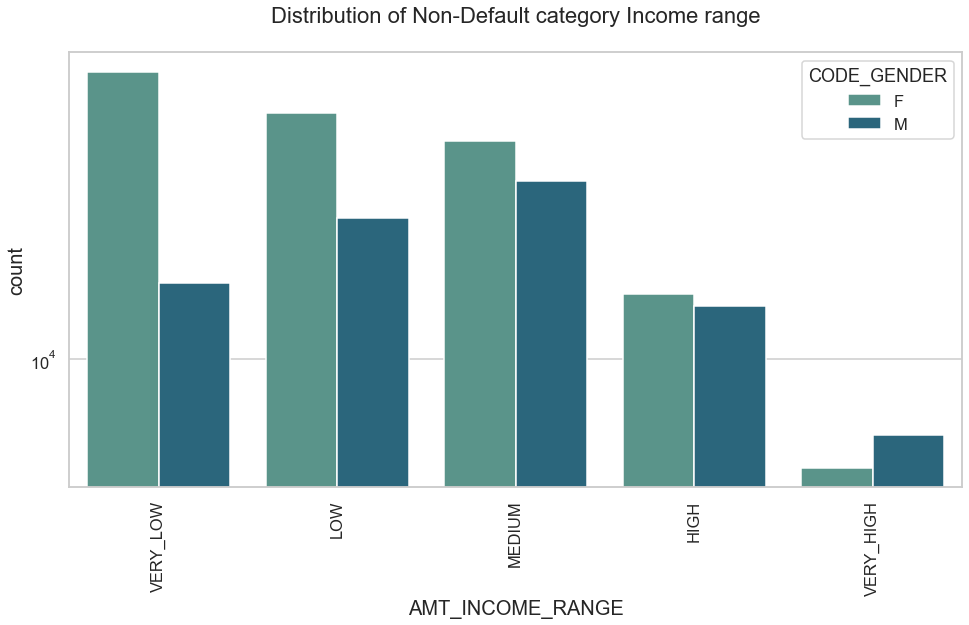

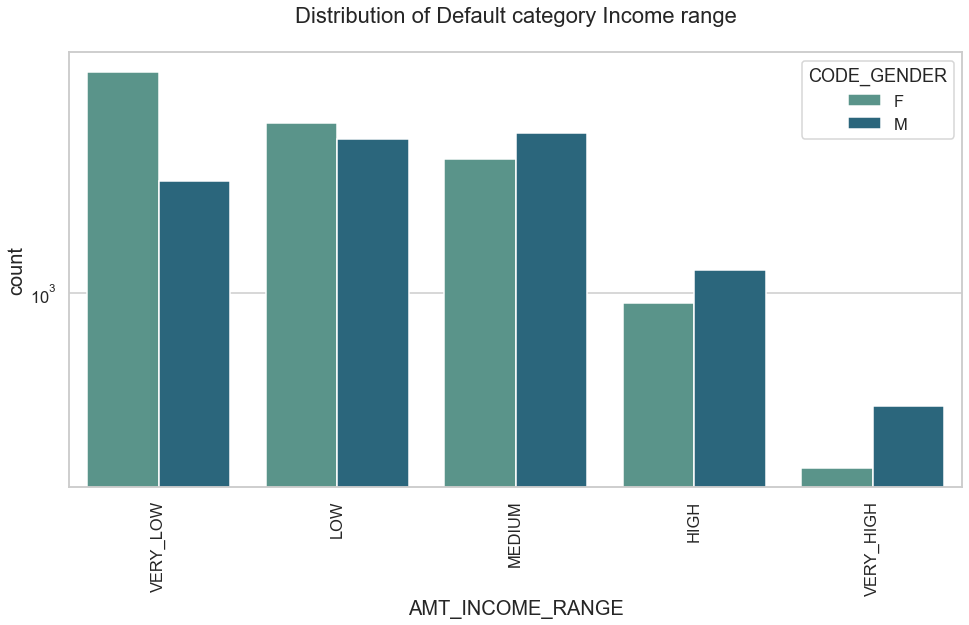

In [63]:
# PLotting for income range
uniplot(target0, col='AMT_INCOME_RANGE',
        title='Distribution of Non-Default category Income range', hue='CODE_GENDER')
uniplot(target1, col='AMT_INCOME_RANGE',
        title='Distribution of Default category Income range', hue='CODE_GENDER')

### Points to be concluded from the above graph.

1. Female counts are higher than male in both default and non-default targets.
2. Income ranging from very low to Medium bucket is having more number of credits in both targets.
3. Both targets shows females are more than male in having credits for range from low to medium bucket.
4. Very less count for income range betweeen high and very high for both targets.

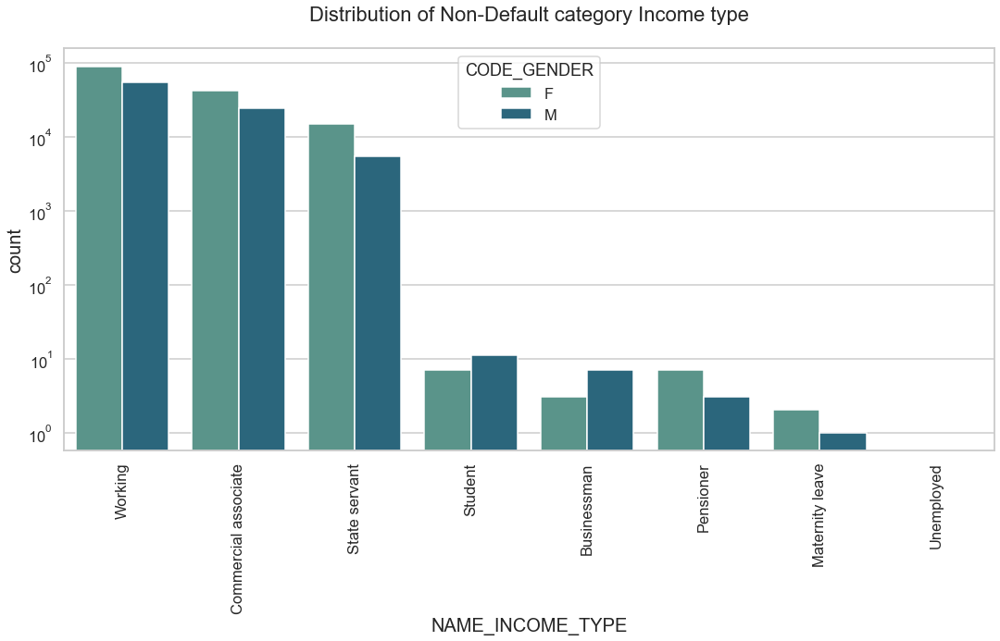

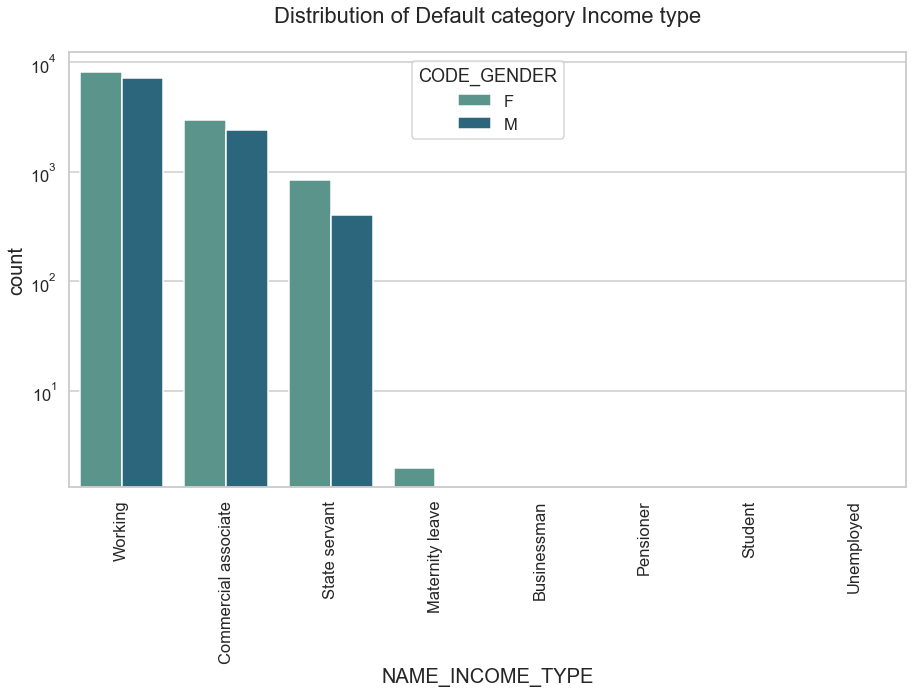

In [64]:
# PLotting for income type
uniplot(target0, col='NAME_INCOME_TYPE',
        title='Distribution of Non-Default category Income type', hue='CODE_GENDER')
uniplot(target1, col='NAME_INCOME_TYPE',
        title='Distribution of Default category Income type', hue='CODE_GENDER')

### Points to be concluded from the above graph.

1. For income type ‘working’, ’commercial associate’, and ‘State Servant’ the number of credits are higher than others in both default and non-default targets.
2. For both targets, Females are having more number of credits than male.
3. For default target, less number of credits for income type ‘Maternity leave’.
4. For default target: There is no income type for ‘student’ , ’pensioner’ and ‘Businessman’ which means they don’t do any late payments.
   

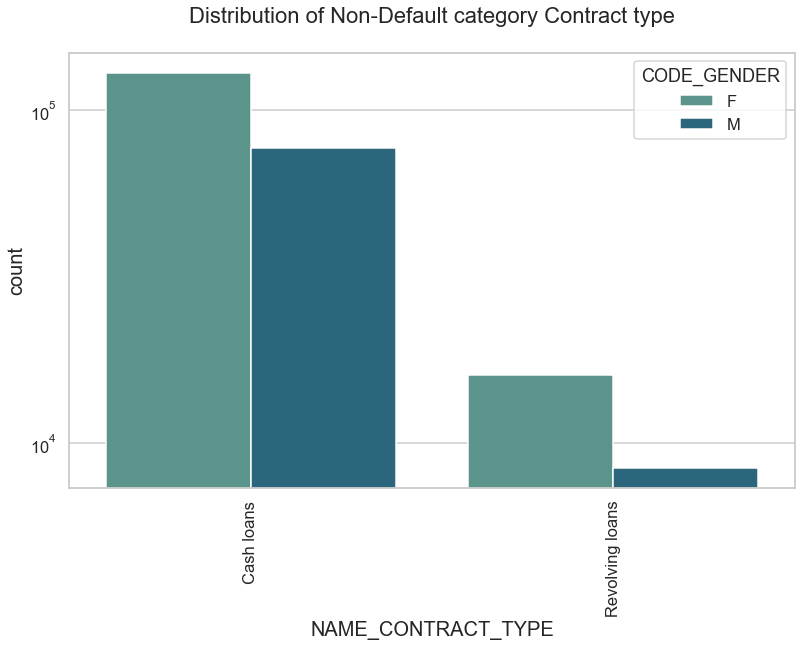

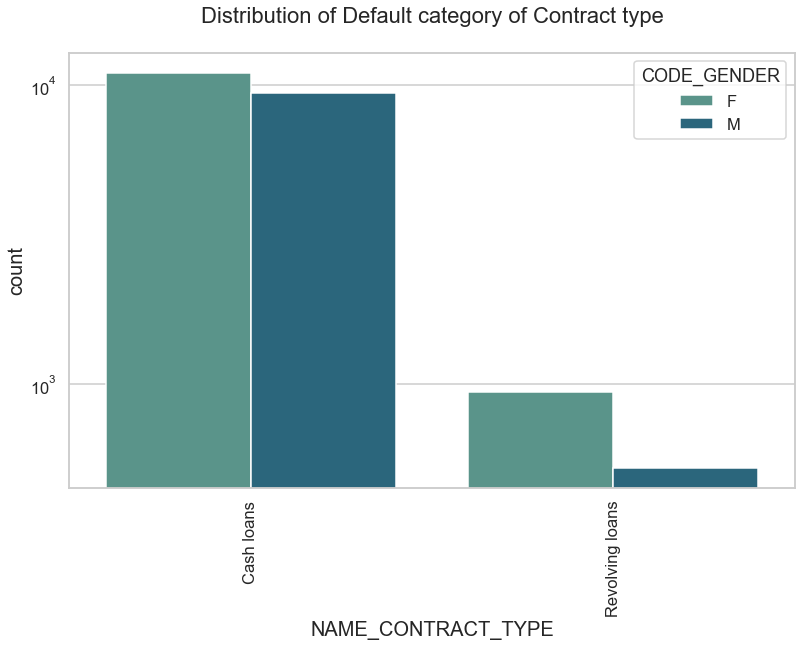

In [65]:
# PLotting for contract type
uniplot(target0, col='NAME_CONTRACT_TYPE',
        title='Distribution of Non-Default category Contract type', hue='CODE_GENDER')
uniplot(target1, col='NAME_CONTRACT_TYPE',
        title='Distribution of Default category of Contract type', hue='CODE_GENDER')

### Points to be concluded from the above graph.

1. For both targets, contract type ‘cash loans’ is having higher number of credits than ‘Revolving loans’ contract type.
2. Again for this as well Female is leading for applying credits.

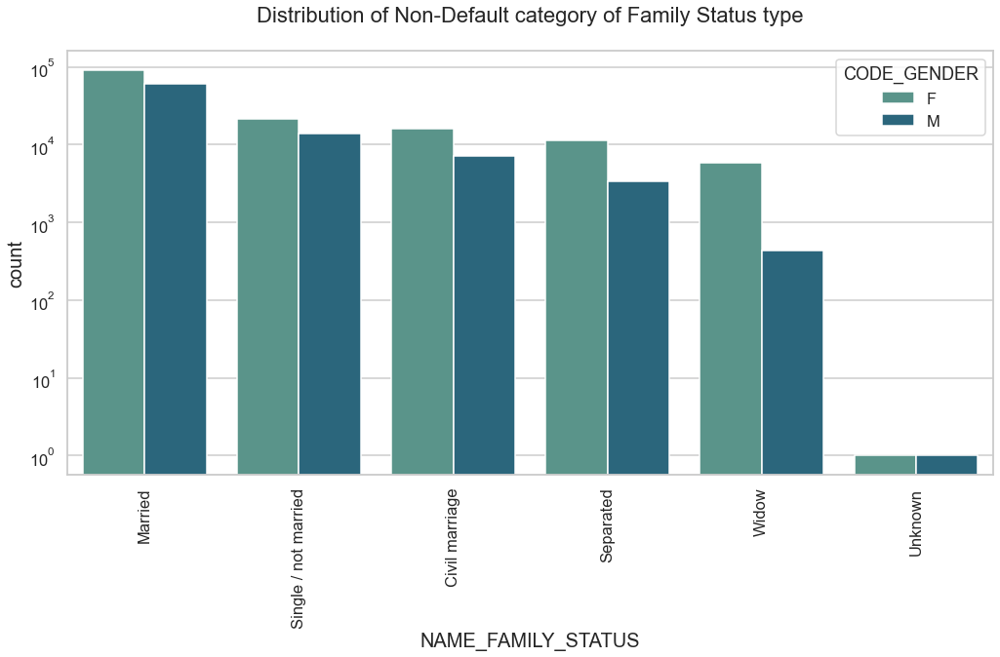

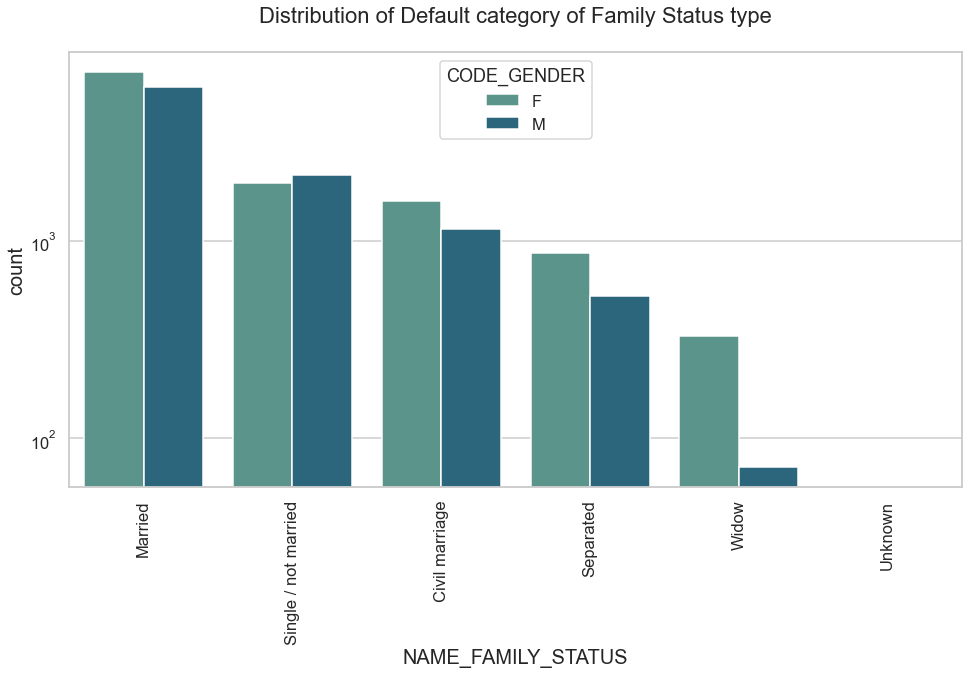

In [66]:
# PLotting for Family status type
uniplot(target0, col='NAME_FAMILY_STATUS',
        title='Distribution of Non-Default category of Family Status type', hue='CODE_GENDER')
uniplot(target1, col='NAME_FAMILY_STATUS',
        title='Distribution of Default category of Family Status type', hue='CODE_GENDER')

### Points to be concluded from above graph.
1. For both targets Female is leading for applying for more credits.
2. Married from both genders have applied for more credits.
3. We observe a decrease in the percentage of widow in both the targets.
4. For target1, in widow category , male percentage is low compare to female.

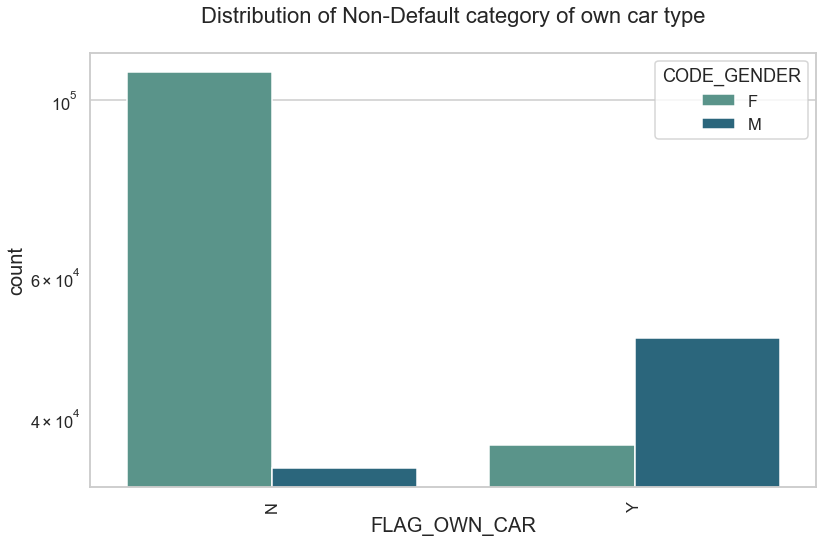

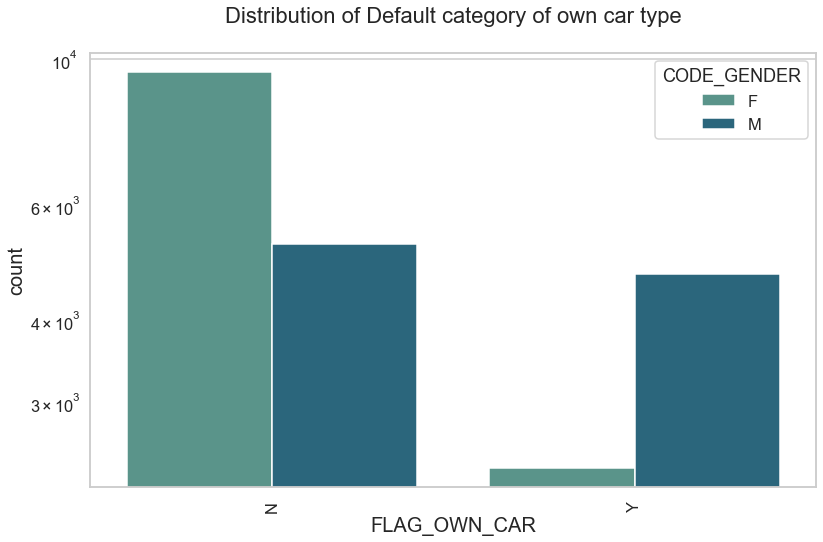

In [67]:
# PLotting for Flag own car type
uniplot(target0, col='FLAG_OWN_CAR',
        title='Distribution of Non-Default category of own car type', hue='CODE_GENDER')
uniplot(target1, col='FLAG_OWN_CAR',
        title='Distribution of Default category of own car type', hue='CODE_GENDER')

#### Points to be concluded
1. Count in both the targets is higher for customers who do not own car . 
2. Among genders female ratio is higher who do not own a car in both targets.
3. Male percentage is significantly lower in non-default category who do not own a car.
4. Female percentage is very less in both the targets who own a car.

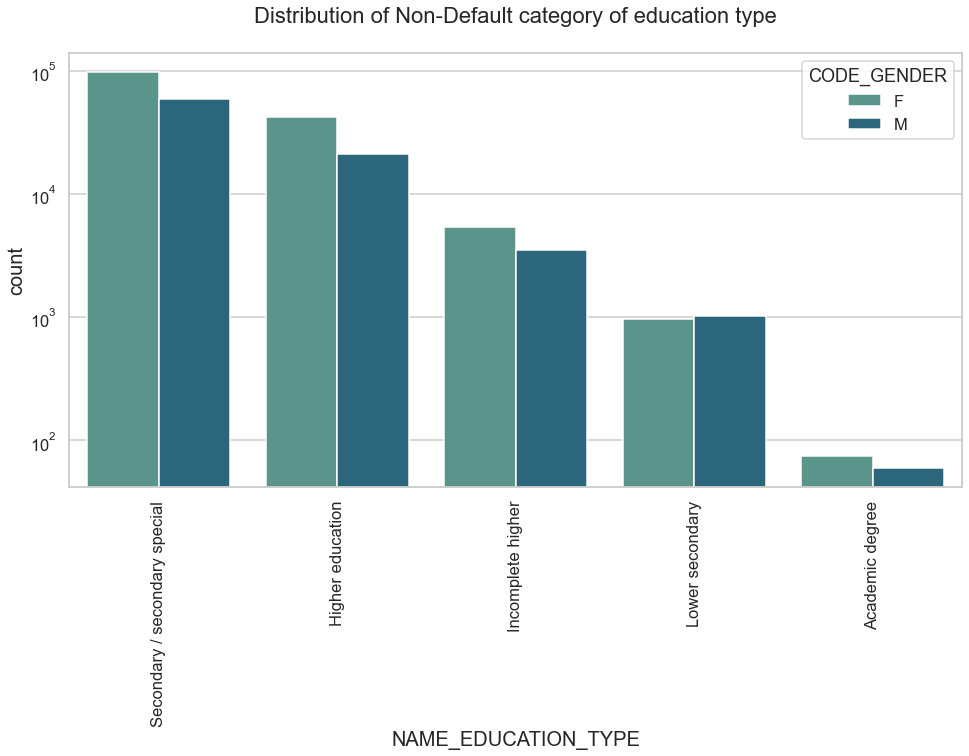

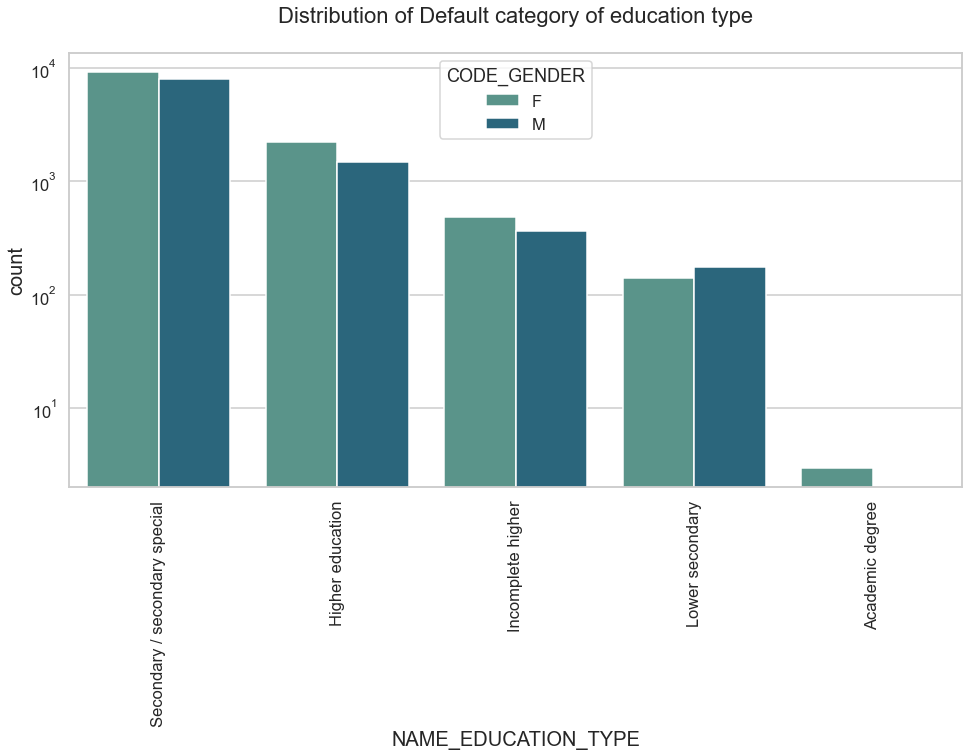

In [68]:
# PLotting for education type
uniplot(target0, col='NAME_EDUCATION_TYPE',
        title='Distribution of Non-Default category of education type', hue='CODE_GENDER')
uniplot(target1, col='NAME_EDUCATION_TYPE',
        title='Distribution of Default category of education type', hue='CODE_GENDER')

#### Points to be concluded
1. Females are leading in both the targets in application.
2. Among category for both genders in both the targets, 'Secondary/Secondary special holders are the highest number.
3. 'Academic degree' in both the targets are the lowest among both genders.
4. For default target, there is no male count for 'Academic degree' holder.

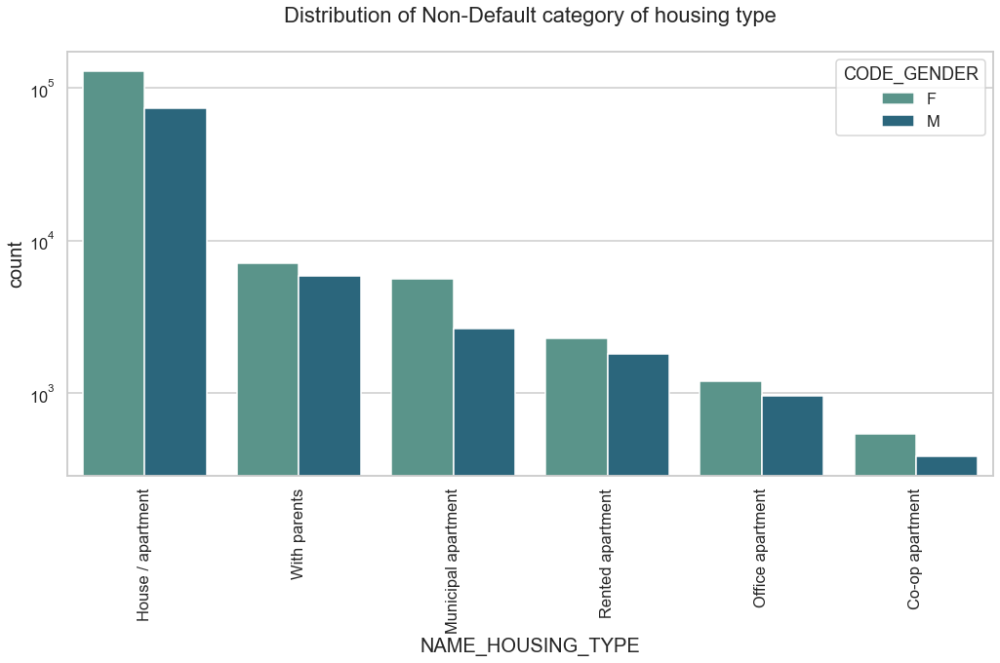

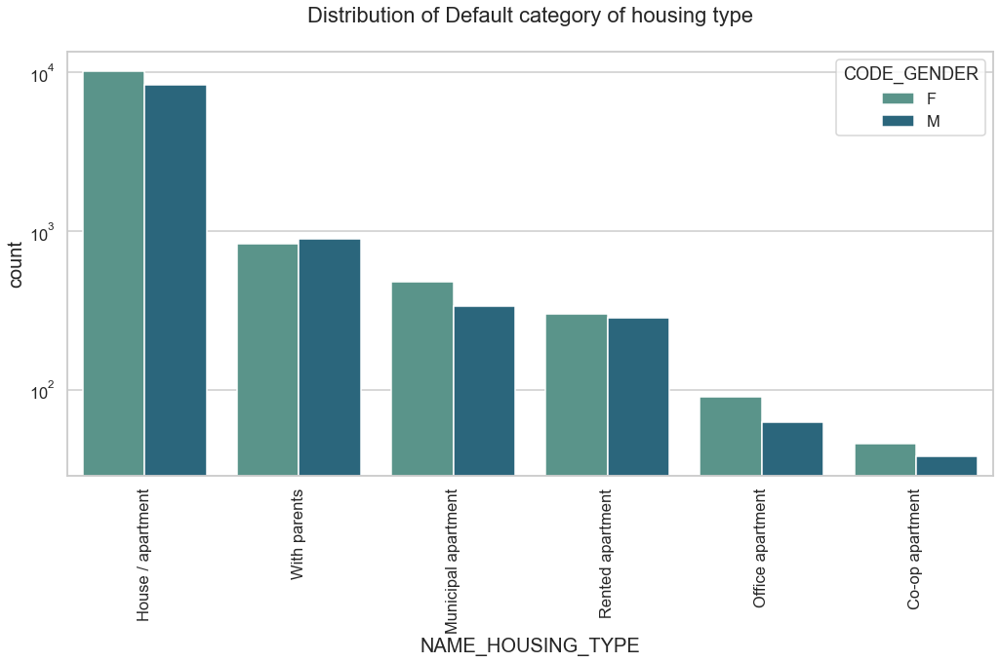

In [69]:
# PLotting for housing type
uniplot(target0, col='NAME_HOUSING_TYPE',
        title='Distribution of Non-Default category of housing type', hue='CODE_GENDER')
uniplot(target1, col='NAME_HOUSING_TYPE',
        title='Distribution of Default category of housing type', hue='CODE_GENDER')

#### Points to be concluded from above graph
1. There is not much variance in housing categories between non-default and default.
2. Here as well count of female is higher than male in both targets.

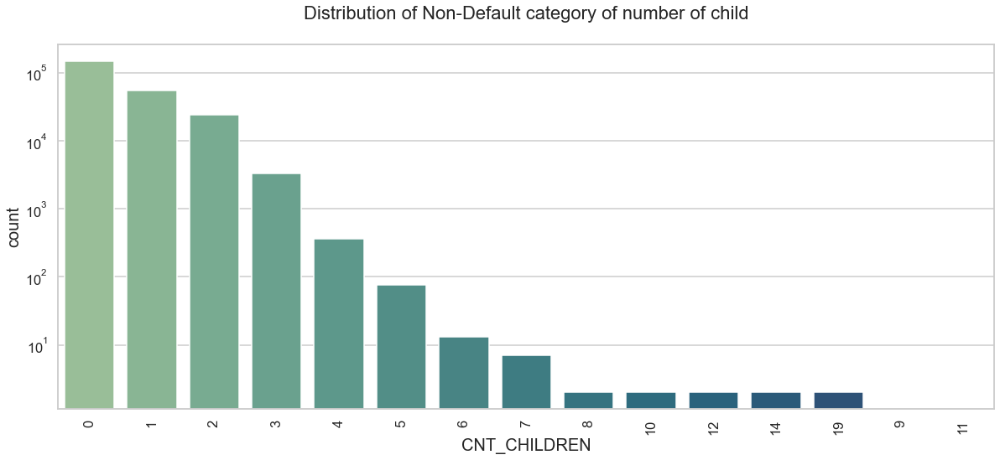

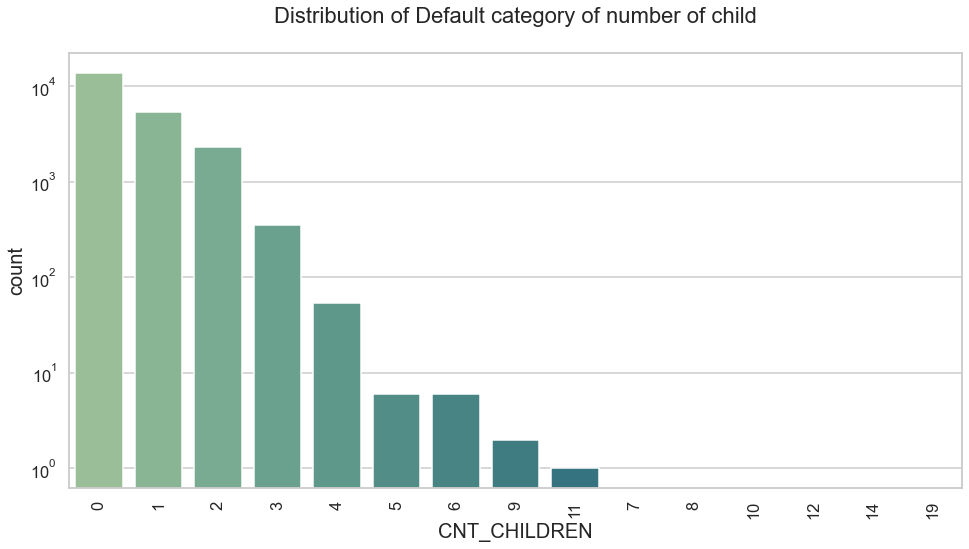

In [70]:
# PLotting for number of child
uniplot(target0, col='CNT_CHILDREN',
        title='Distribution of Non-Default category of number of child')
uniplot(target1, col='CNT_CHILDREN',
        title='Distribution of Default category of number of child')

#### Points to conclude from above graph
1. We see a common pattern in both the targets till the count of 4 child.
2. In target1, for non-default clients we see application who has more 10 child as well.
3. Also, there is declining pattern in both the target as count of child increases.

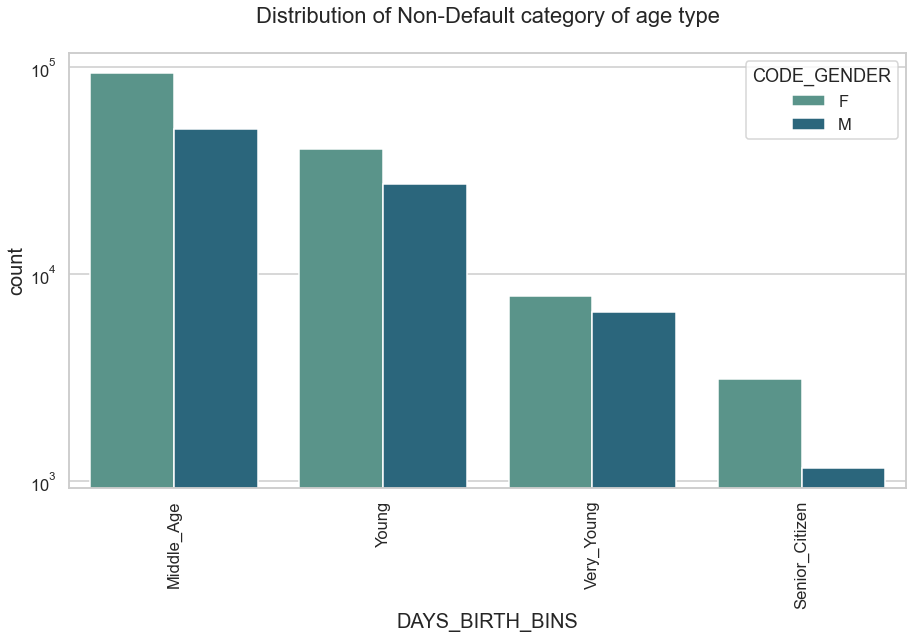

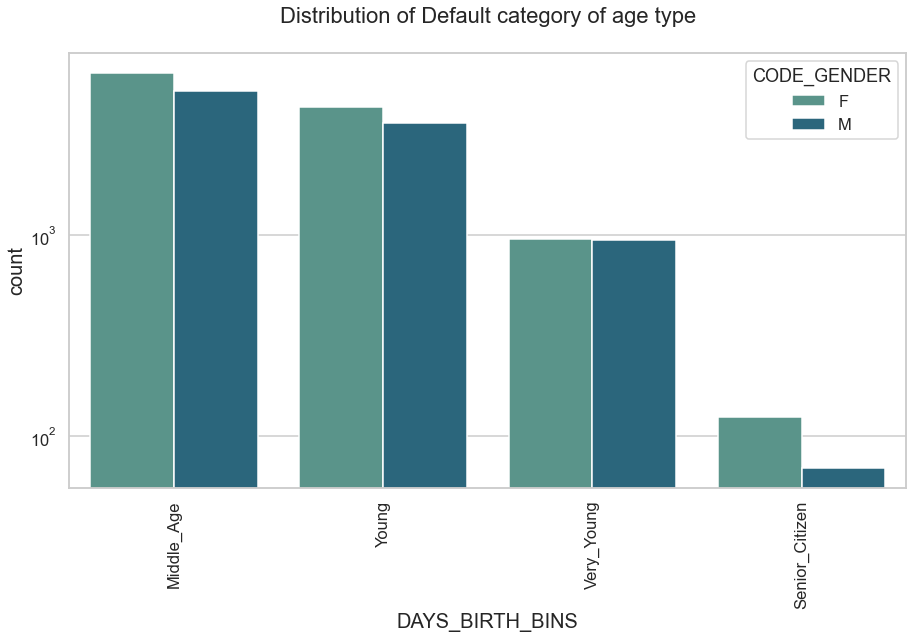

In [71]:
# PLotting for age type
uniplot(target0, col='DAYS_BIRTH_BINS',
        title='Distribution of Non-Default category of age type', hue='CODE_GENDER')
uniplot(target1, col='DAYS_BIRTH_BINS',
        title='Distribution of Default category of age type', hue='CODE_GENDER')

#### Points to be concluded from above graph
1. Female count is higher in both the targets compare to men.
2. 'Middle age' group count is higher among both genders and both the targets.
3. 'Very young' age group count is higher in defaulter category compare to non-default.
4. Among 'Senior citizen' age group female count is more than double in both the targets.

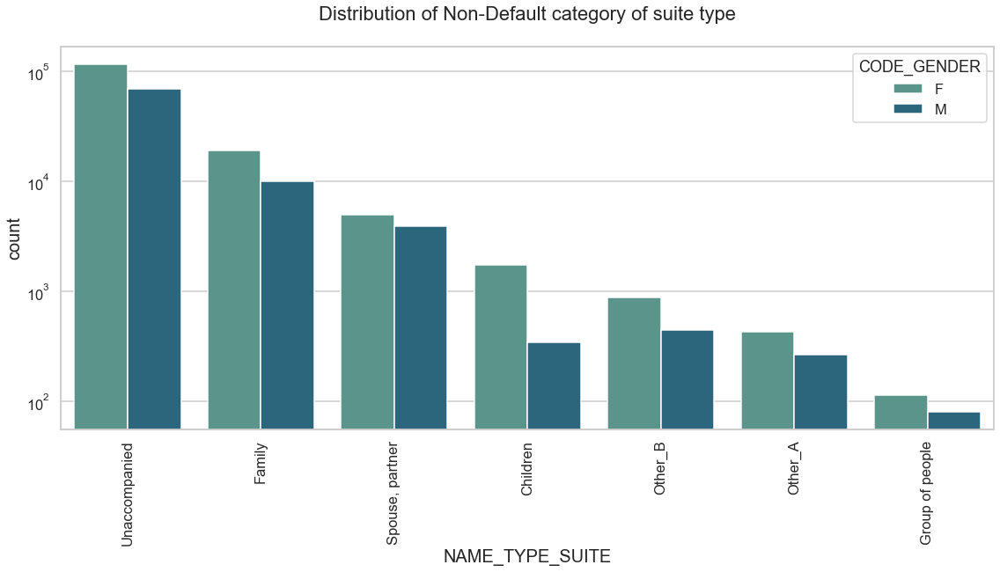

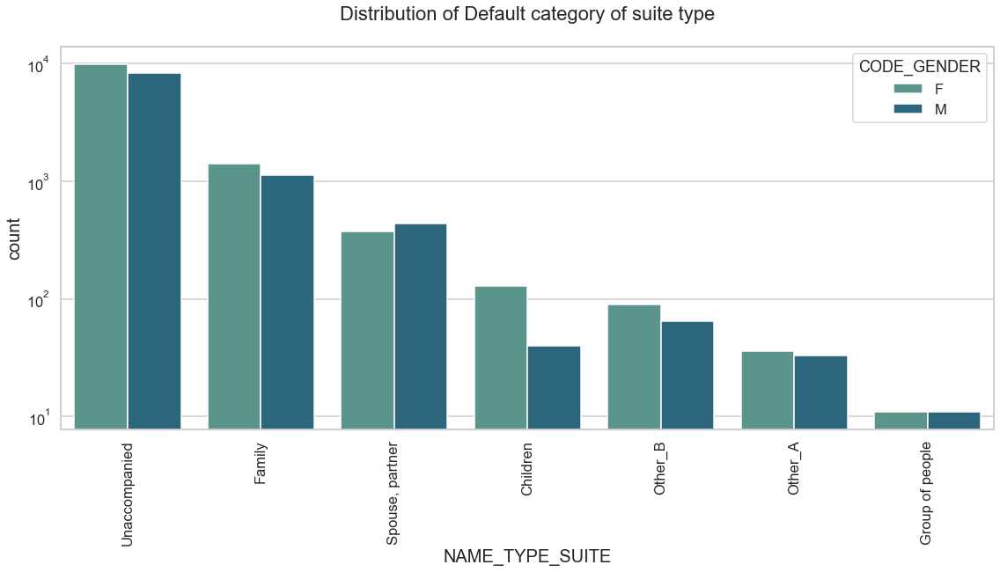

In [72]:
# PLotting for client accompanied at the time of loan application
uniplot(target0, col='NAME_TYPE_SUITE',
        title='Distribution of Non-Default category of suite type', hue='CODE_GENDER')
uniplot(target1, col='NAME_TYPE_SUITE',
        title='Distribution of Default category of suite type', hue='CODE_GENDER')

#### Points to be concluded from the above graph
1. Most of clients were unaccompanied at the application processing time in both the targets.
2. Rest we don't see any major chage as all groups have shows similar counts in both the targets.

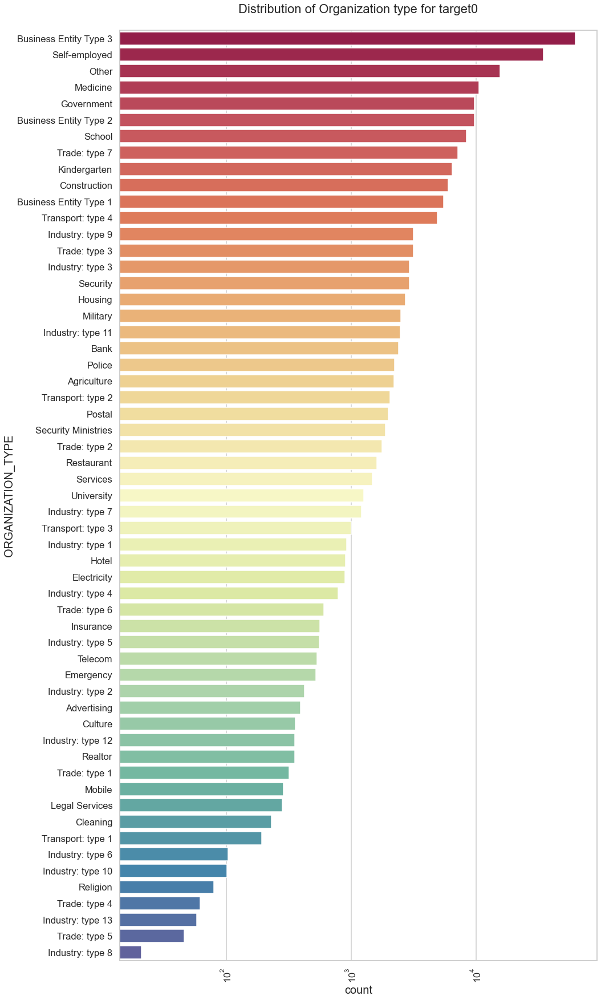

In [73]:
# Plotting 'Organization type' for target0 in logarithmic scale

sns.set_style('whitegrid')
sns.set_context('talk')
plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30

plt.title("Distribution of Organization type for target0")

plt.xticks(rotation=90)
plt.xscale('log')

sns.countplot(data=target0,y='ORGANIZATION_TYPE',order=target0['ORGANIZATION_TYPE'].value_counts().index,palette='Spectral')

plt.show()

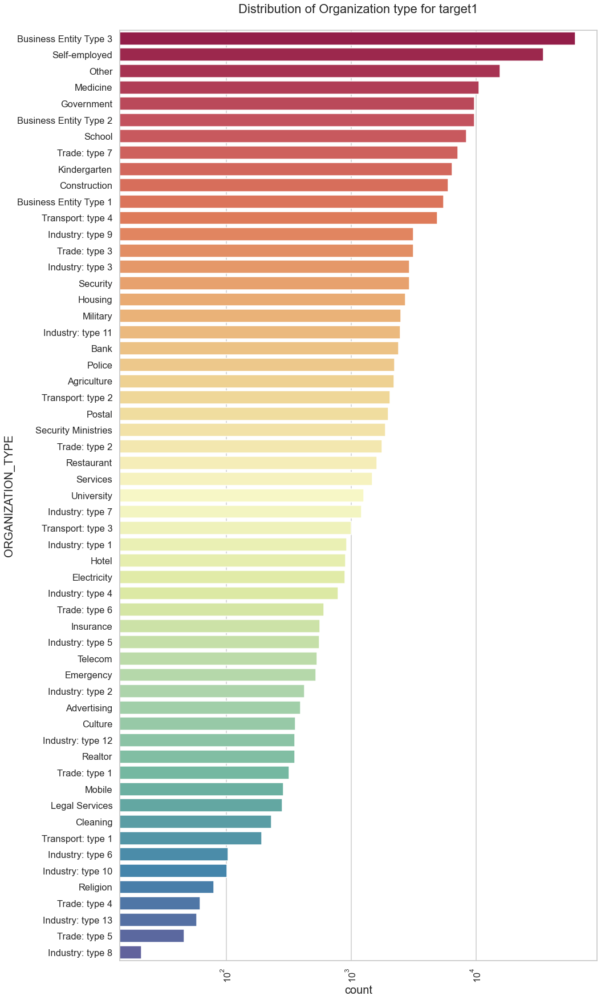

In [74]:
# Plotting 'Organization type' for target1 in logarithmic scale

sns.set_style('whitegrid')
sns.set_context('talk')
plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30

plt.title("Distribution of Organization type for target1")

plt.xticks(rotation=90)
plt.xscale('log')

sns.countplot(data=target0,y='ORGANIZATION_TYPE',order=target0['ORGANIZATION_TYPE'].value_counts().index,palette='Spectral')

plt.show()

#### Points to be concluded from the above graph.

1. Clients which have applied for credits are from most of the organization type ‘Business entity Type 3’ , ‘Self employed’, ‘Other’ , ‘Medicine’ and ‘Government’ for both targets.
2. Less clients are from Industry type 8,type 6, type 10, religion and trade type 5, type 4.
3. Both targets are similar in distribution.

## 8.2 Correlation of Numerical Variables on the basis of both 'Target' Variables

In [75]:
target0.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 230302 entries, 1 to 307510
Data columns (total 53 columns):
 #   Column                        Non-Null Count   Dtype   
---  ------                        --------------   -----   
 0   SK_ID_CURR                    230302 non-null  object  
 1   TARGET                        230302 non-null  category
 2   NAME_CONTRACT_TYPE            230302 non-null  category
 3   CODE_GENDER                   230302 non-null  category
 4   FLAG_OWN_CAR                  230302 non-null  category
 5   FLAG_OWN_REALTY               230302 non-null  category
 6   CNT_CHILDREN                  230302 non-null  category
 7   AMT_INCOME_TOTAL              230302 non-null  float64 
 8   AMT_CREDIT                    230302 non-null  float64 
 9   AMT_ANNUITY                   230290 non-null  float64 
 10  AMT_GOODS_PRICE               230065 non-null  float64 
 11  NAME_TYPE_SUITE               229267 non-null  category
 12  NAME_INCOME_TYPE              

In [76]:
# Finding some correlation for numerical columns for both target 0 and 1 

target_0 = target0[['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_BIRTH','DAYS_EMPLOYED',
                     'DAYS_REGISTRATION','DAYS_ID_PUBLISH']].corr(method = 'pearson')
target_0

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH
AMT_INCOME_TOTAL,1.000000,0.326155,0.400757,0.333312,0.045638,0.029933,-0.034431,0.026460
AMT_CREDIT,0.326155,1.000000,0.762117,0.986726,0.152597,0.087327,0.015289,0.035172
AMT_ANNUITY,0.400757,0.762117,1.000000,0.766945,0.091514,0.052036,-0.009678,0.026039
AMT_GOODS_PRICE,0.333312,0.986726,0.766945,1.000000,0.146762,0.088476,0.011931,0.036977
DAYS_BIRTH,0.045638,0.152597,0.091514,0.146762,1.000000,0.351910,0.298690,0.106699
DAYS_EMPLOYED,0.029933,0.087327,0.052036,0.088476,0.351910,1.000000,0.171907,0.086145
DAYS_REGISTRATION,-0.034431,0.015289,-0.009678,0.011931,0.298690,0.171907,1.000000,0.029329
DAYS_ID_PUBLISH,0.026460,0.035172,0.026039,0.036977,0.106699,0.086145,0.029329,1.000000


In [77]:
# Finding some correlation for numerical columns for both target b1 
target_1 = target1[['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_BIRTH','DAYS_EMPLOYED',
                     'DAYS_REGISTRATION','DAYS_ID_PUBLISH']].corr(method = 'pearson')
target_1

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH
AMT_INCOME_TOTAL,1.000000,0.036484,0.043358,0.036097,0.007761,-0.000040,0.003958,0.008054
AMT_CREDIT,0.036484,1.000000,0.748708,0.982799,0.189282,0.106293,0.033293,0.062314
AMT_ANNUITY,0.043358,0.748708,1.000000,0.749379,0.090212,0.048552,-0.014162,0.044119
AMT_GOODS_PRICE,0.036097,0.982799,0.749379,1.000000,0.185405,0.111970,0.032173,0.064721
DAYS_BIRTH,0.007761,0.189282,0.090212,0.185405,1.000000,0.306509,0.240920,0.134840
DAYS_EMPLOYED,-0.000040,0.106293,0.048552,0.111970,0.306509,1.000000,0.138400,0.096647
DAYS_REGISTRATION,0.003958,0.033293,-0.014162,0.032173,0.240920,0.138400,1.000000,0.049692
DAYS_ID_PUBLISH,0.008054,0.062314,0.044119,0.064721,0.134840,0.096647,0.049692,1.000000


## 8.3 Plotting the above correlation with heat map to visulaize

In [78]:

def targets_corr(data,title):
    plt.figure(figsize=(15, 10))
    plt.rcParams['axes.titlesize'] = 25
    plt.rcParams['axes.titlepad'] = 70

# heatmap with a color map of choice


    sns.heatmap(data, cmap="Set3",annot=False)

    plt.title(title)
    plt.yticks(rotation=0)
    plt.show()

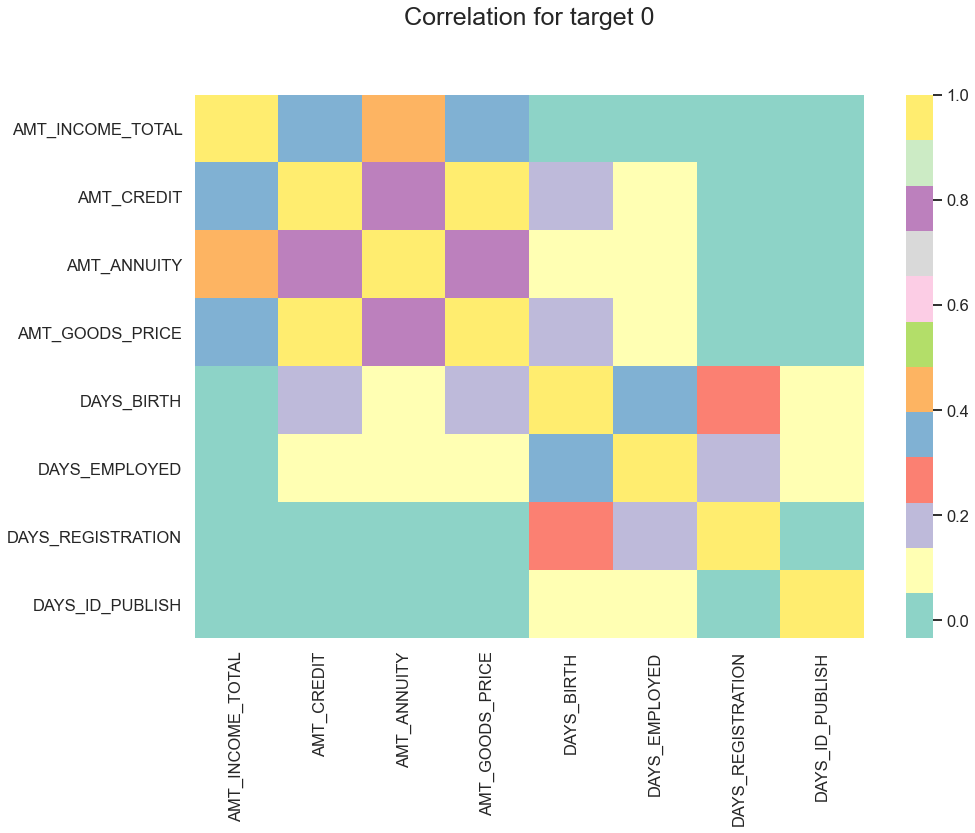

In [79]:
# For Target 0
targets_corr(data=target_0,title='Correlation for target 0')

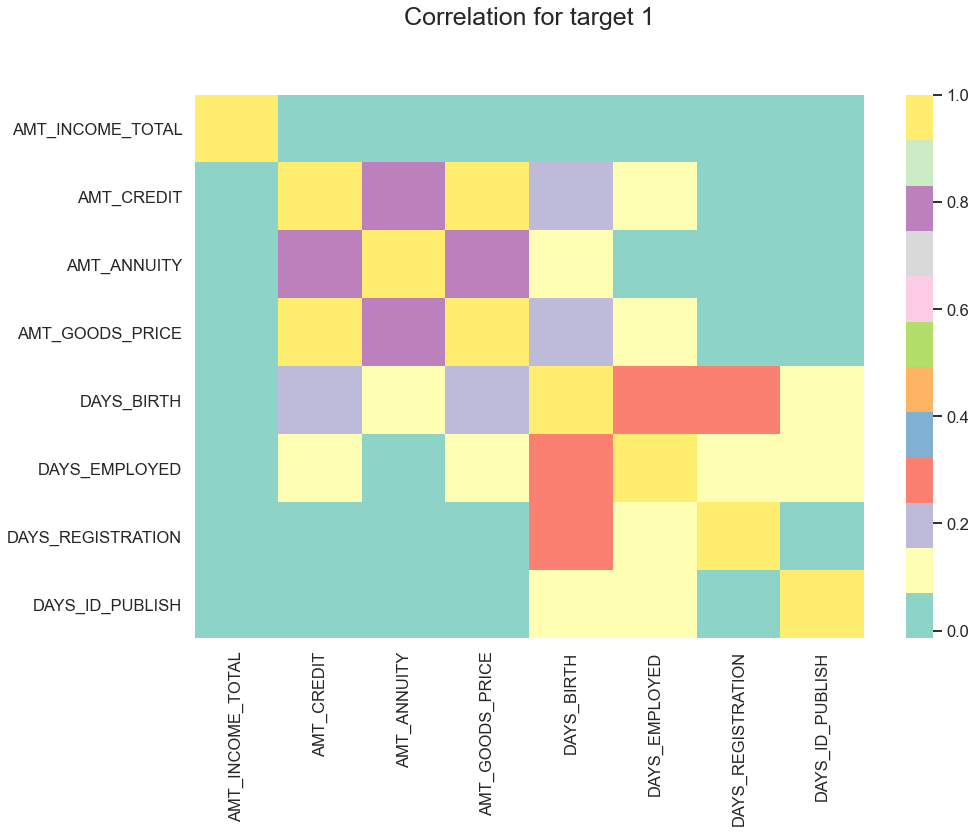

In [80]:
# For Target 1
targets_corr(data=target_1,title='Correlation for target 1')

#### Points to be concluded from above graph
1. We observe that there is a high correlation between credit amount and goods price for both the targets.
2. Total income is inversely proportional to the date of birth, which means total income is less for low age and vice-versa for both the targets.
3. Total income is inversely proportional to the days employed, which means total income is less for low employment number of days and vice-versa for both the targets.

## 8.4 Univariate Analysis of Numerical Variables on the basis of 'Target' Variable


### 8.4.1 For Target 0

In [81]:
# Function for univariate plots
def univariate_numerical(df,col,hue =None):
    sns.set(style="darkgrid")
    fig, ax=plt.subplots(nrows =1,ncols=2,figsize=(20,8))
    ax[0].set_title("Distribution Plot")
    sns.distplot(df[~df[col].isna()][col],ax=ax[0], color="#4CB391")
    plt.yscale('log')
    ax[1].set_title("Box Plot")
    sns.boxplot(data =df, y=col,ax=ax[1],orient='v', color="#4CB391")
    plt.yscale('log')
    plt.show()

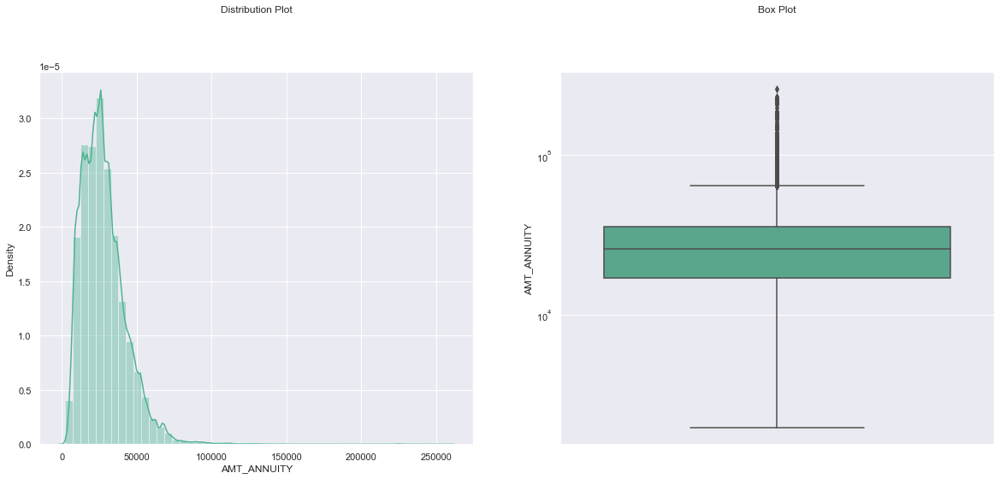

In [82]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan Non-Payment Difficulties
univariate_numerical(df=target0,col='AMT_ANNUITY')


### Points to be concluded from the above graphs
1. Outliers are noticed in annuity amount.
2. First quartile is bigger than third quartile for annuity amount which means most of the annuity clients are from first quartile

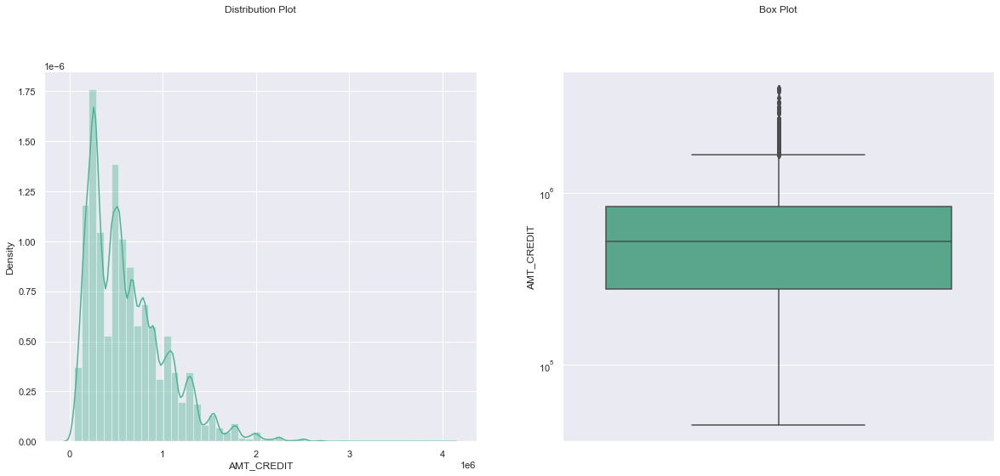

In [83]:
# Distribution and Box plot for 'AMT_CREDIT' for Loan Non-Payment Difficulties
univariate_numerical(df=target0,col='AMT_CREDIT')

#### Points to be concluded from the above graphs
1. Outliers are noticed in credit amount.
2. First quartile is bigger than third quartile for credit amount which means most of the credits of clients are present in the first quartile.

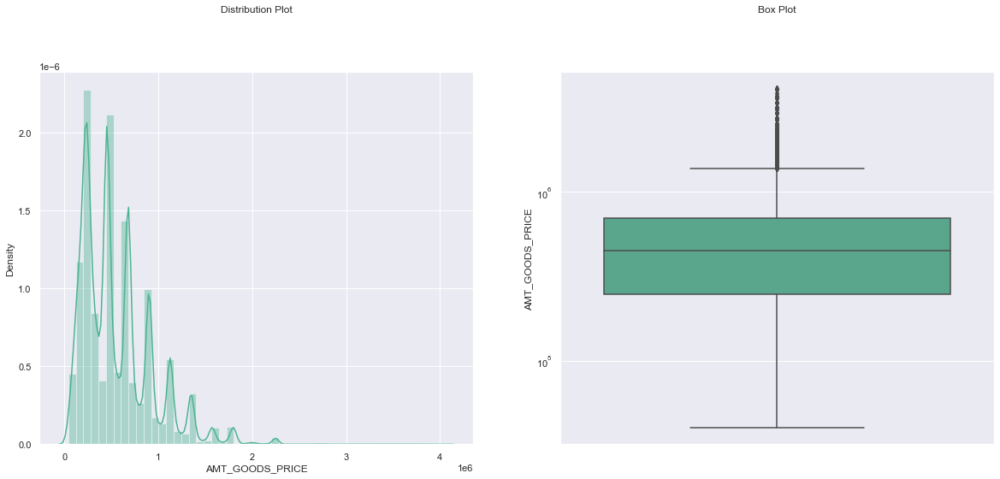

In [84]:
#Distribution and Box plot for 'AMT_GOODS_PRICE' for Loan- Non-Payment Difficulties
univariate_numerical(df=target0,col='AMT_GOODS_PRICE')

#### Points to be concluded from the above graphs
1. Outliers are noticed in consumer goods price.
2. First quartile is bigger than third quartile for annuity amount which means most of the consumer goods price are from first quartile.

### 8.4.2 For Target 1

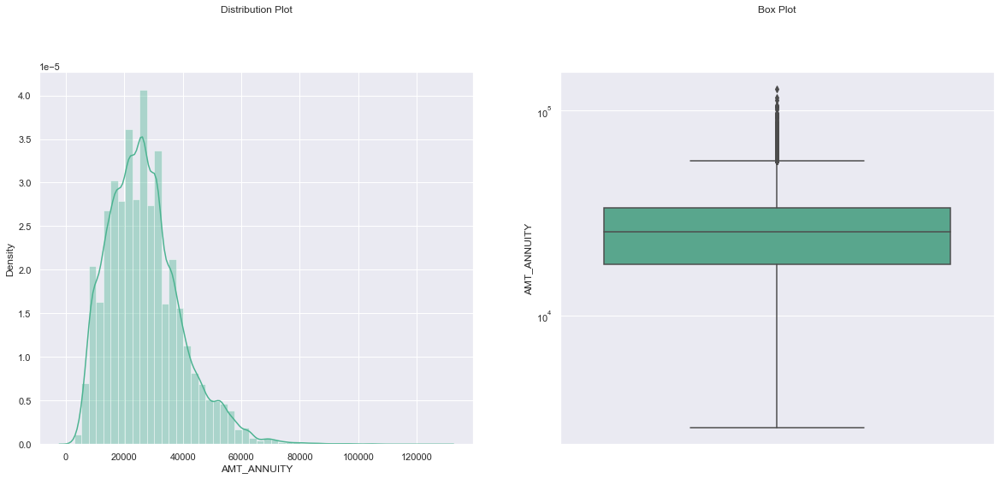

In [85]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan Payment Difficulties
univariate_numerical(df=target1,col='AMT_ANNUITY')

#### Points to be concluded from the above graphs
1. Outliers are noticed in consumer goods price.
2. First quartile is bigger than third quartile for annuity amount which means most of the annuity clients are from first quartile.

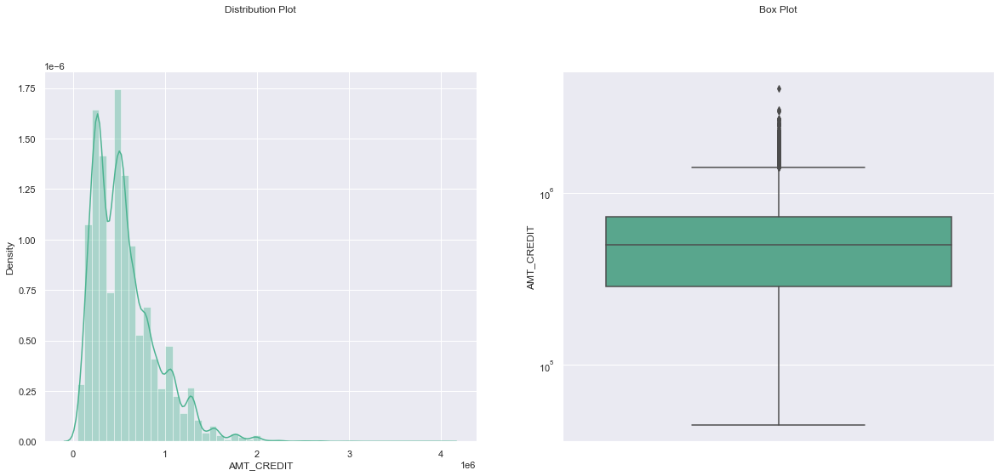

In [86]:
# Distribution and Box plot for 'AMT_CREDIT' for Loan Payment Difficulties
univariate_numerical(df=target1,col='AMT_CREDIT')

#### Points to be concluded from the above graphs
1. Outliers are noticed in credit amount.
2. First quartile is bigger than third quartile for credit amount which means most of the credits of clients are present in the first quartile.

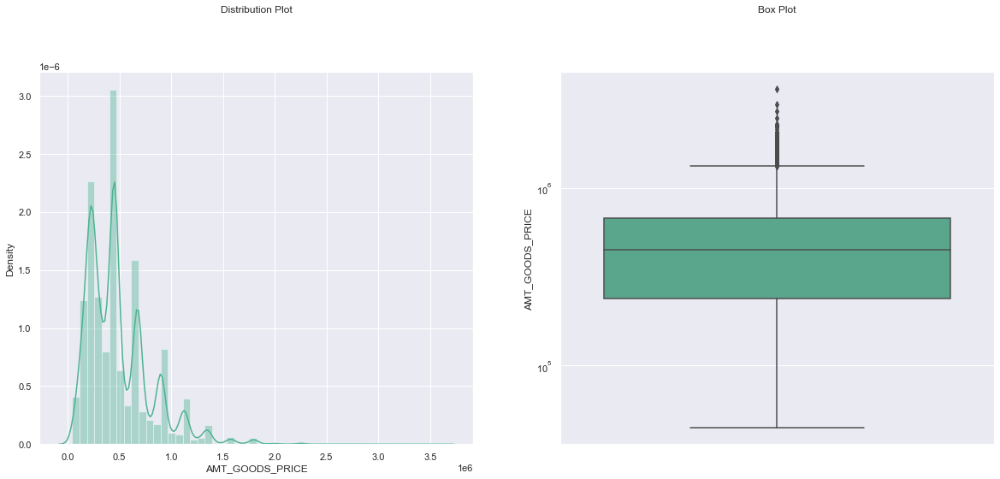

In [87]:
#Distribution and Box plot for 'AMT_GOODS_PRICE' for Loan Payment Difficulties
univariate_numerical(df=target1,col='AMT_GOODS_PRICE')

#### Points to be concluded from the above graphs
1. Outliers are noticed in consumer goods price.
2. First quartile is bigger than third quartile for annuity amount which means most of the consumer goods price are from first quartile.

## 9. Bivariate Analysis

### 9.1 Bivariate Analysis of numerical variables


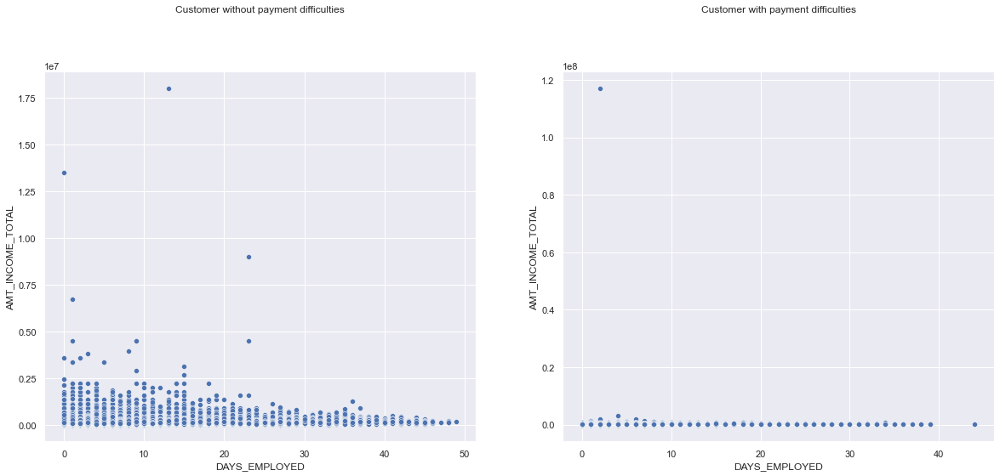

In [88]:
plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.scatterplot(data=target0[target0['DAYS_EMPLOYED']<1000], x='DAYS_EMPLOYED',y='AMT_INCOME_TOTAL')
plt.title('Customer without payment difficulties')

plt.subplot(1,2,2)
ax = sns.scatterplot(data=target1[target1['DAYS_EMPLOYED']<1000], x='DAYS_EMPLOYED',y='AMT_INCOME_TOTAL')
plt.title('Customer with payment difficulties')
plt.show()

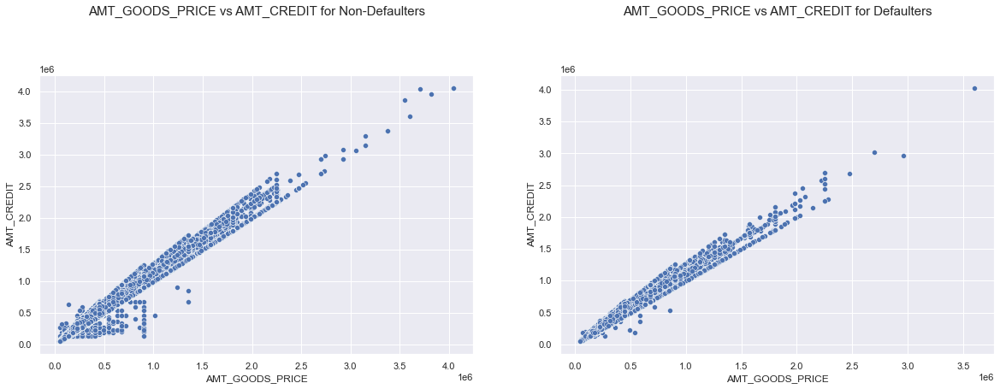

In [89]:
# Scatter plot for 'AMT_GOODS_PRICE' and 'AMT_CREDIT'
fig,(ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
sns.scatterplot(x=target0.AMT_GOODS_PRICE, y=target0.AMT_CREDIT,data=target0,ax=ax1)
ax1.set_xlabel('AMT_GOODS_PRICE')    
ax1.set_ylabel('AMT_CREDIT')
ax1.set_title('AMT_GOODS_PRICE vs AMT_CREDIT for Non-Defaulters',fontsize=15)
    
sns.scatterplot(x=target1.AMT_GOODS_PRICE, y=target1.AMT_CREDIT,data=target1,ax=ax2)
ax2.set_xlabel('AMT_GOODS_PRICE')    
ax2.set_ylabel('AMT_CREDIT')
ax2.set_title('AMT_GOODS_PRICE vs AMT_CREDIT for Defaulters',fontsize=15)
            
plt.show()

#### we can see that goods price is positively correlated with credit amount.

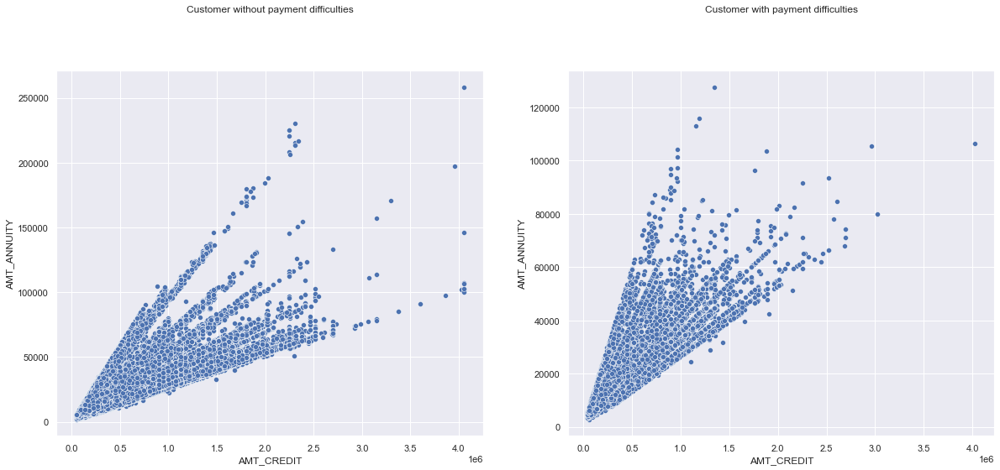

In [90]:
# Scatter plot for'AMT_CREDIT' and 'AMT_ANNUITY'

plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.scatterplot(data=target0,x='AMT_CREDIT',y='AMT_ANNUITY')
plt.title('Customer without payment difficulties')


plt.subplot(1,2,2)
ax = sns.scatterplot(data=target1,x='AMT_CREDIT',y='AMT_ANNUITY')
plt.title('Customer with payment difficulties')

plt.show()


#### People without payment difficuties take more credit for the annuity that they have

In [91]:
target0.AMT_CREDIT.describe()

count    2.303020e+05
mean     6.164879e+05
std      4.114378e+05
min      4.500000e+04
25%      2.762775e+05
50%      5.212800e+05
75%      8.353800e+05
max      4.050000e+06
Name: AMT_CREDIT, dtype: float64

In [92]:
# Box plotting function for Non-Defaulter case for Income
def bivarboxplot(var1,var2,huevar):
    plt.figure(figsize=(15,10))
    plt.xticks(rotation=90)
    sns.boxplot(data =target0, x=var1,y=var2, hue =huevar,orient='v')
    plt.title('Education Status vs Credit Amount for Non-Defaulter')
    plt.show()

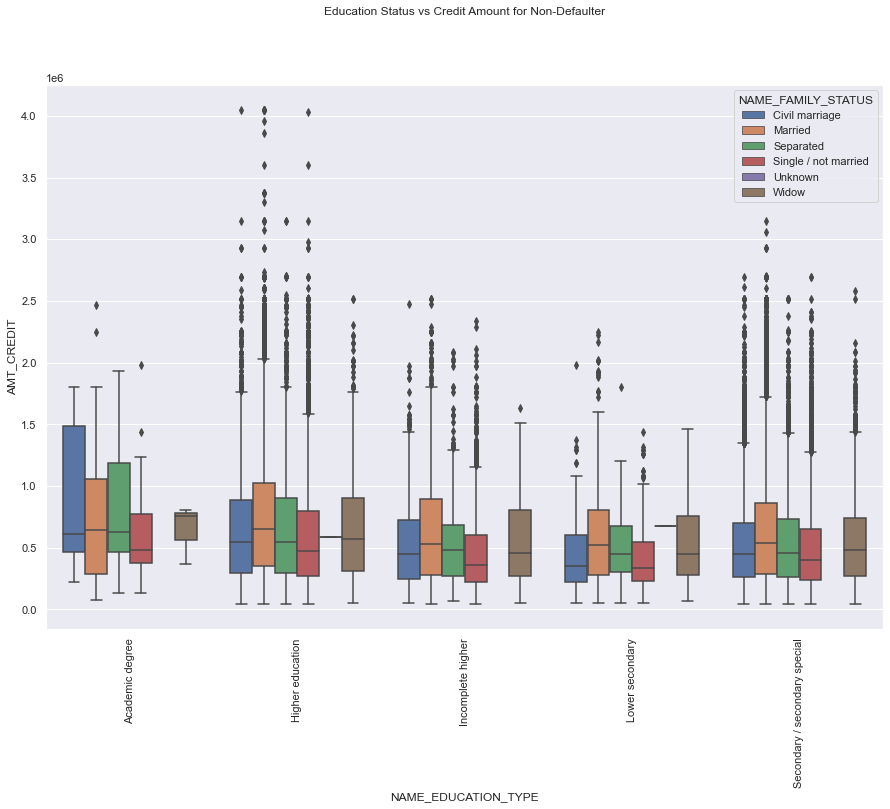

In [93]:
bivarboxplot('NAME_EDUCATION_TYPE','AMT_CREDIT','NAME_FAMILY_STATUS')

In [94]:
# Box plotting function for Defaulter case for Income
def bivarboxplotdef(var1,var2,huevar):
    plt.figure(figsize=(15,10))
    plt.xticks(rotation=90)
    sns.boxplot(data =target1, x=var1,y=var2, hue ='NAME_FAMILY_STATUS',orient='v')
    plt.title('Education Status vs Credit Amount for Defaulter')
    plt.show()

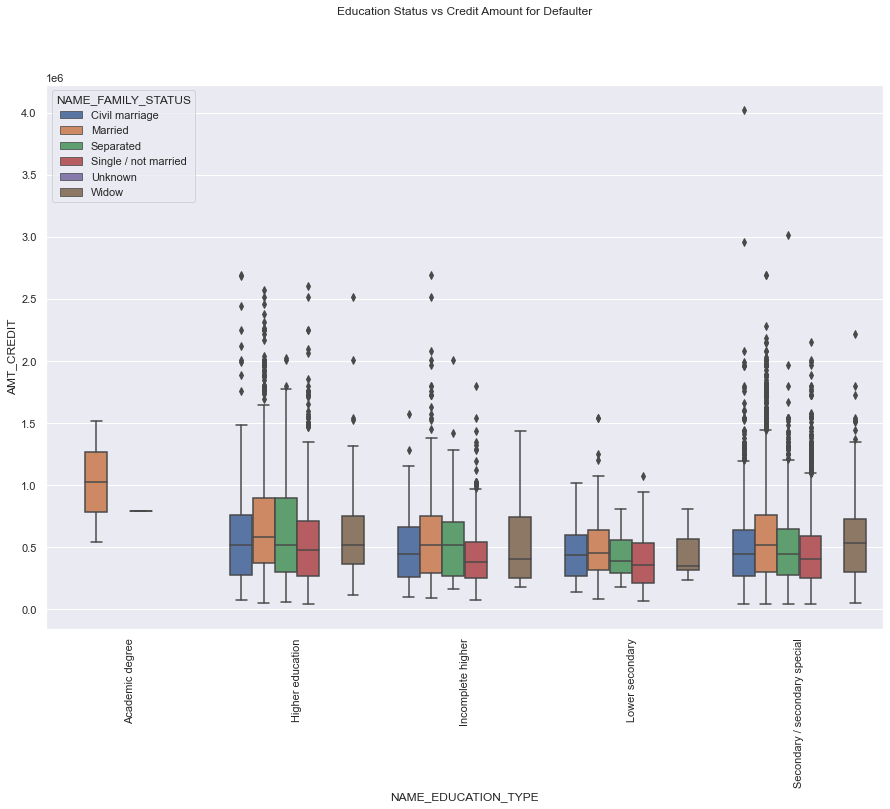

In [95]:
bivarboxplotdef('NAME_EDUCATION_TYPE','AMT_CREDIT','NAME_FAMILY_STATUS')

#### From above boxplot.
1. For Education type 'Higher education' the income amount is mostly equal with family status. It does contain many outliers. 
2. Less outlier  for Academic degree but income amount is higher for Higher education. 
3. Lower secondary of civil marriage family status have less income amount than others.

### 9.3 Bivariate Analysis Categorical - Categorical 

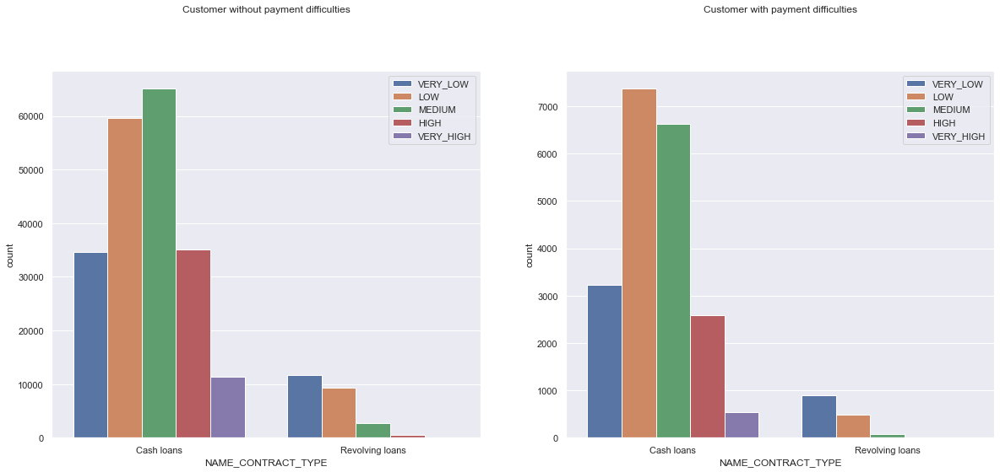

In [96]:
plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.countplot(data=target0,x='NAME_CONTRACT_TYPE',hue='AMT_CREDIT_RANGE')
plt.title('Customer without payment difficulties')
plt.legend(loc='upper right')


plt.subplot(1,2,2)
ax = sns.countplot(data=target1,x='NAME_CONTRACT_TYPE',hue='AMT_CREDIT_RANGE')
plt.title('Customer with payment difficulties')
plt.legend(loc='upper right')
plt.show()


### 
1. For Target 0 and 1, there is no much variance. 
2. Both targets have high cash loans in low and medium category.

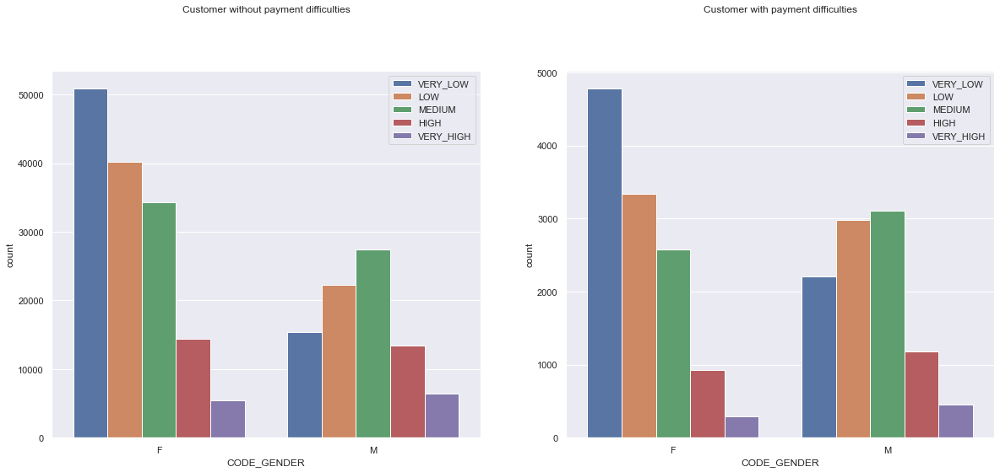

In [97]:
plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.countplot(data=target0,x='CODE_GENDER',hue='AMT_INCOME_RANGE')
plt.title('Customer without payment difficulties')
plt.legend(loc='upper right')


plt.subplot(1,2,2)
ax = sns.countplot(data=target1,x='CODE_GENDER',hue='AMT_INCOME_RANGE')
plt.title('Customer with payment difficulties')
plt.legend(loc='upper right')
plt.show()

### 
1. For Target 0 and 1, there is no much variance. 
2. Both targets have high count of females from very low to medium categories.

### 9.4 Bivariate Analysis Numerical - Categorical

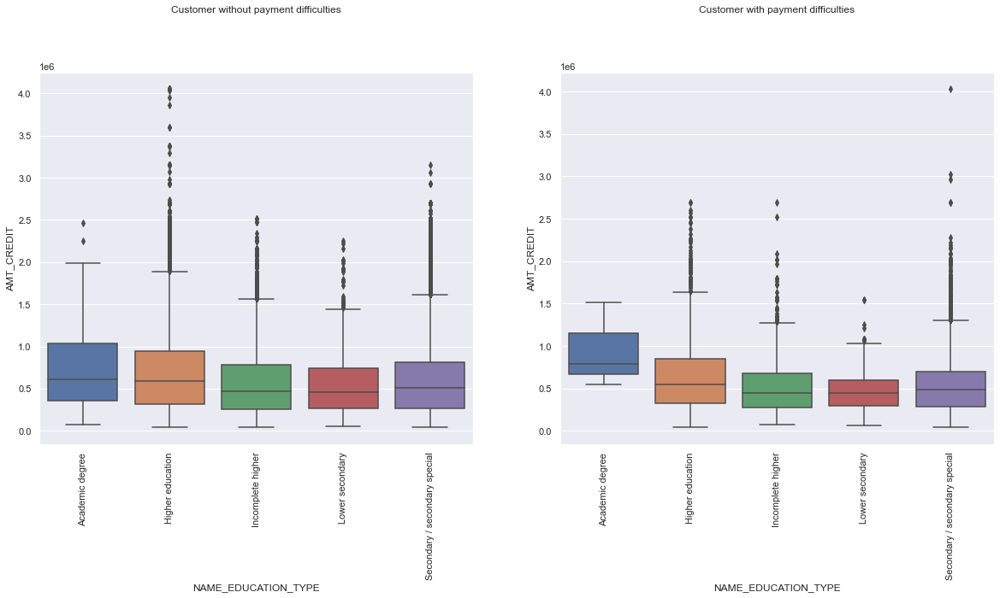

In [98]:
plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.boxplot(data=target0,y='AMT_CREDIT',x='NAME_EDUCATION_TYPE')
plt.title('Customer without payment difficulties')
plt.xticks(rotation=90)

plt.subplot(1,2,2)
ax = sns.boxplot(data=target1,y='AMT_CREDIT',x='NAME_EDUCATION_TYPE')
plt.title('Customer with payment difficulties')
plt.xticks(rotation=90)
plt.show()


#### Here we can see that the range of customers without payment of Academic degree is higher than the customer of with payment. And the rest of the Education type is almost same for both the cases.


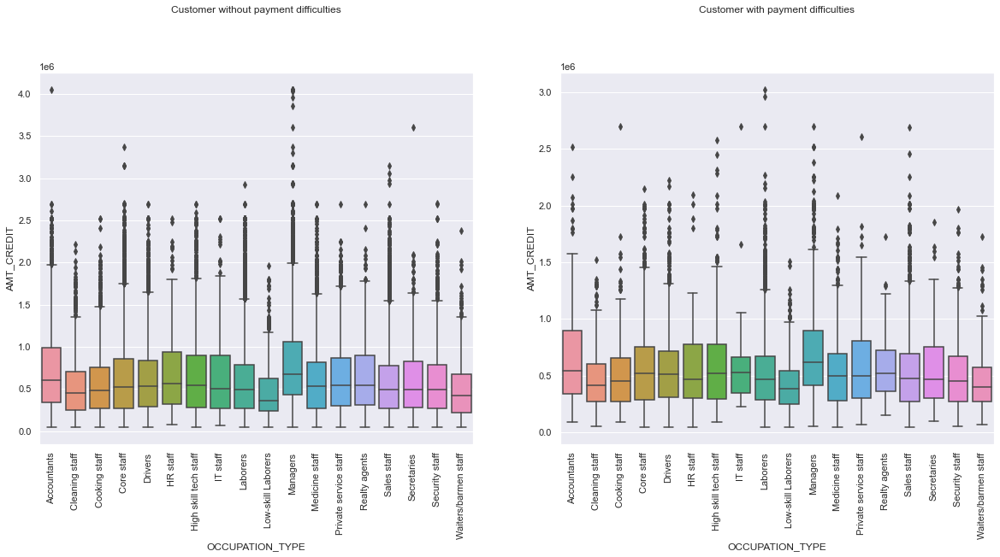

In [99]:
plt.figure(figsize=(20,8)) 

plt.subplot(1,2,1)
ax = sns.boxplot(data=target0,y='AMT_CREDIT',x='OCCUPATION_TYPE')
plt.title('Customer without payment difficulties')
plt.xticks(rotation=90)

plt.subplot(1,2,2)
ax = sns.boxplot(data=target1,y='AMT_CREDIT',x='OCCUPATION_TYPE')
plt.title('Customer with payment difficulties')
plt.xticks(rotation=90)
plt.show()

#### We can see in above graph that the range of the customers without payment are more as compare to the customers with payment.

## 10. Data Analysis For Previous Application Data

In [100]:
# Removing all the columns with more than 50% of null values
Previous_Application = Previous_Application.loc[:,Previous_Application.isnull().mean()<=0.5]
Previous_Application.shape

(1670214, 33)

In [101]:
# Cleaning the missing data

# listing the null values columns having more than 30%

emptycol1=Previous_Application.isnull().sum()
emptycol1=emptycol1[emptycol1.values>(0.3*len(emptycol1))]
len(emptycol1)

11

In [102]:
# Removing those 15 columns

emptycol1 = list(emptycol1[emptycol1.values>=0.3].index)
Previous_Application.drop(labels=emptycol1,axis=1,inplace=True)

Previous_Application.shape

(1670214, 22)

In [103]:
# Removing the column values of 'XNA' and 'XAP'

Previous_Application=Previous_Application.drop(Previous_Application[Previous_Application['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
Previous_Application=Previous_Application.drop(Previous_Application[Previous_Application['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
Previous_Application=Previous_Application.drop(Previous_Application[Previous_Application['NAME_CASH_LOAN_PURPOSE']=='XAP'].index)

Previous_Application.shape

(69635, 22)

In [104]:
# Now merging the Application dataset with previous appliaction dataset

new_df=pd.merge(left=NewApplication,right=Previous_Application,how='inner',on='SK_ID_CURR',suffixes='_x')

In [105]:
# Renaming the column names after merging

new_df1 = new_df.rename({'NAME_CONTRACT_TYPE_' : 'NAME_CONTRACT_TYPE','AMT_CREDIT_':'AMT_CREDIT','AMT_ANNUITY_':'AMT_ANNUITY',
                         'WEEKDAY_APPR_PROCESS_START_' : 'WEEKDAY_APPR_PROCESS_START',
                         'HOUR_APPR_PROCESS_START_':'HOUR_APPR_PROCESS_START','NAME_CONTRACT_TYPEx':'NAME_CONTRACT_TYPE_PREV',
                         'AMT_CREDITx':'AMT_CREDIT_PREV','AMT_ANNUITYx':'AMT_ANNUITY_PREV',
                         'WEEKDAY_APPR_PROCESS_STARTx':'WEEKDAY_APPR_PROCESS_START_PREV',
                         'HOUR_APPR_PROCESS_STARTx':'HOUR_APPR_PROCESS_START_PREV'}, axis=1)


In [106]:
# Removing unwanted columns for analysis

new_df1.drop(['SK_ID_CURR','WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START','REG_CITY_NOT_LIVE_CITY',
              'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY','WEEKDAY_APPR_PROCESS_START_PREV',
              'HOUR_APPR_PROCESS_START_PREV', 'FLAG_LAST_APPL_PER_CONTRACT','NFLAG_LAST_APPL_IN_DAY'],axis=1,inplace=True)

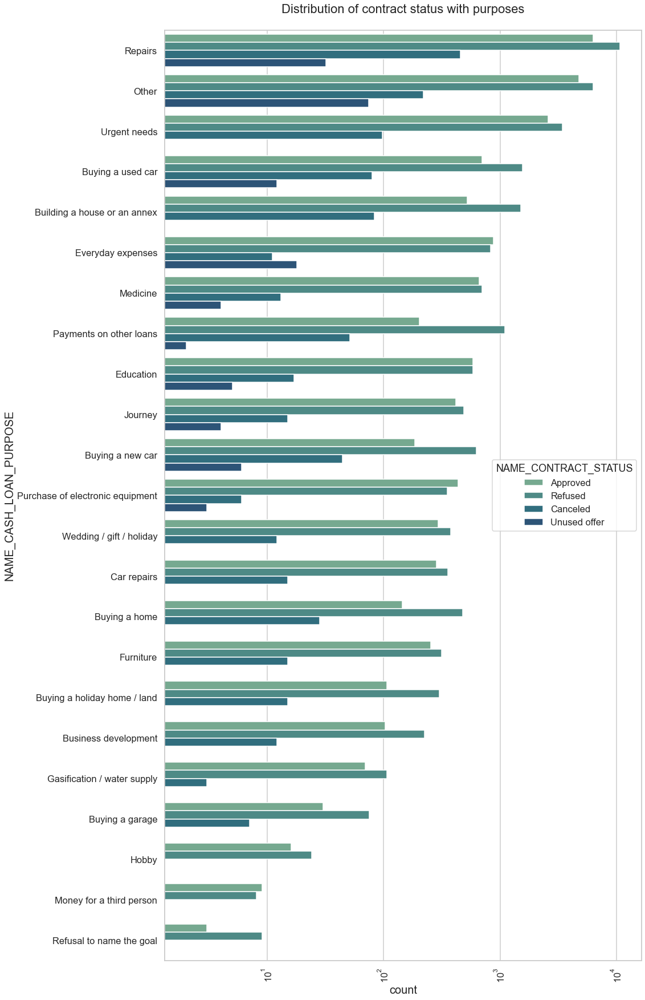

In [107]:
# Distribution of contract status in logarithmic scale

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30
plt.xticks(rotation=90)
plt.xscale('log')
plt.title('Distribution of contract status with purposes')
ax = sns.countplot(data = new_df1, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=new_df1['NAME_CASH_LOAN_PURPOSE'].value_counts().index,hue = 'NAME_CONTRACT_STATUS',palette='crest')

## 10.1 Univariate analysis


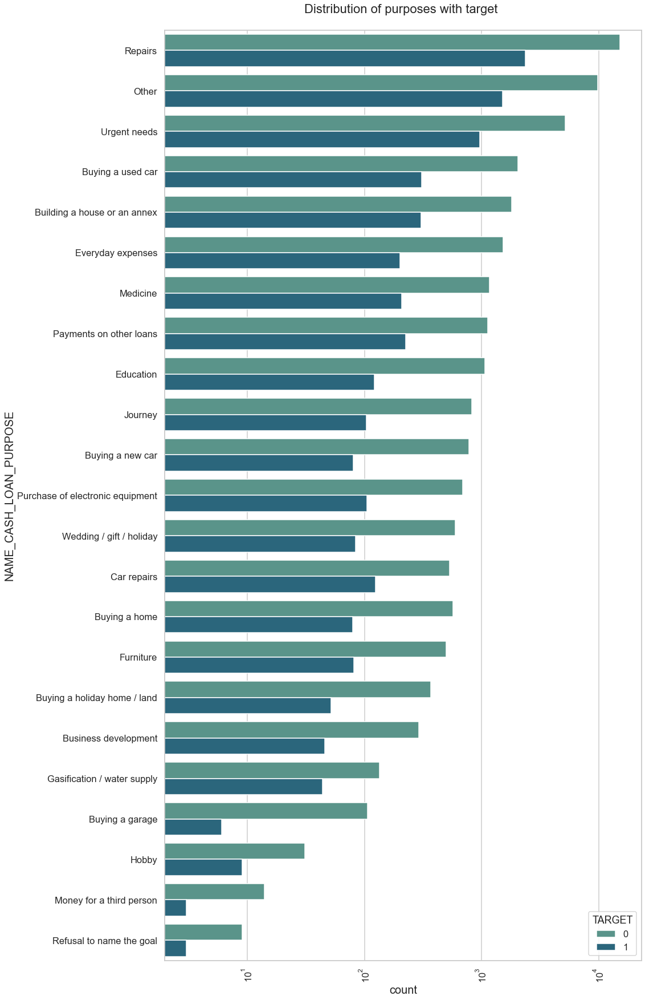

In [108]:
# Distribution of contract status

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30
plt.xticks(rotation=90)
plt.xscale('log')
plt.title('Distribution of purposes with target ')
ax = sns.countplot(data = new_df1, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=new_df1['NAME_CASH_LOAN_PURPOSE'].value_counts().index,hue = 'TARGET',palette='crest')

#### Points we can conclude from abpve plot:

1. Loan purposes with 'Repairs' are facing more difficulties in payment on time.
2. There are few places where loan payment is significant higher than facing difficulties. They are 'Buying a garage', 3.'Business development', 'Buying land', 'Buying a new car' and 'Education' Hence we can focus on these purposes for which the client is having for minimal payment difficulties.

## 10.3 Bivariate Analysis



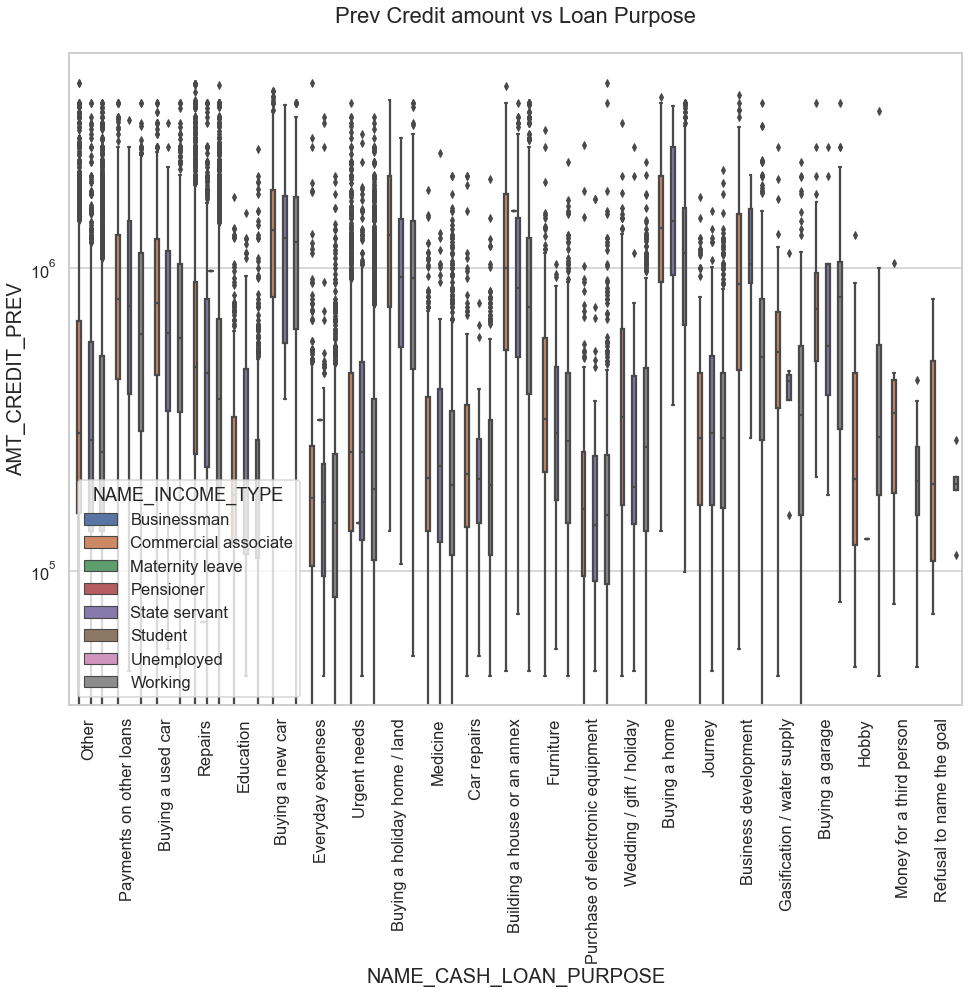

In [109]:
# Box plotting for Credit amount in logarithmic scale

plt.figure(figsize=(16,12))
plt.xticks(rotation=90)
plt.yscale('log')
sns.boxplot(data =new_df1, x='NAME_CASH_LOAN_PURPOSE',hue='NAME_INCOME_TYPE',y='AMT_CREDIT_PREV',orient='v')
plt.title('Prev Credit amount vs Loan Purpose')
plt.show()


#### Points that can concluded.

1. The credit amount of Loan purposes like 'Buying a home', 'Buying a land', 'Buying a new car' and 'Building a house' is higher.
2. Income type of state servants have a significant amount of credit applied
3. Money for third person or a Hobby is having less credits applied for.

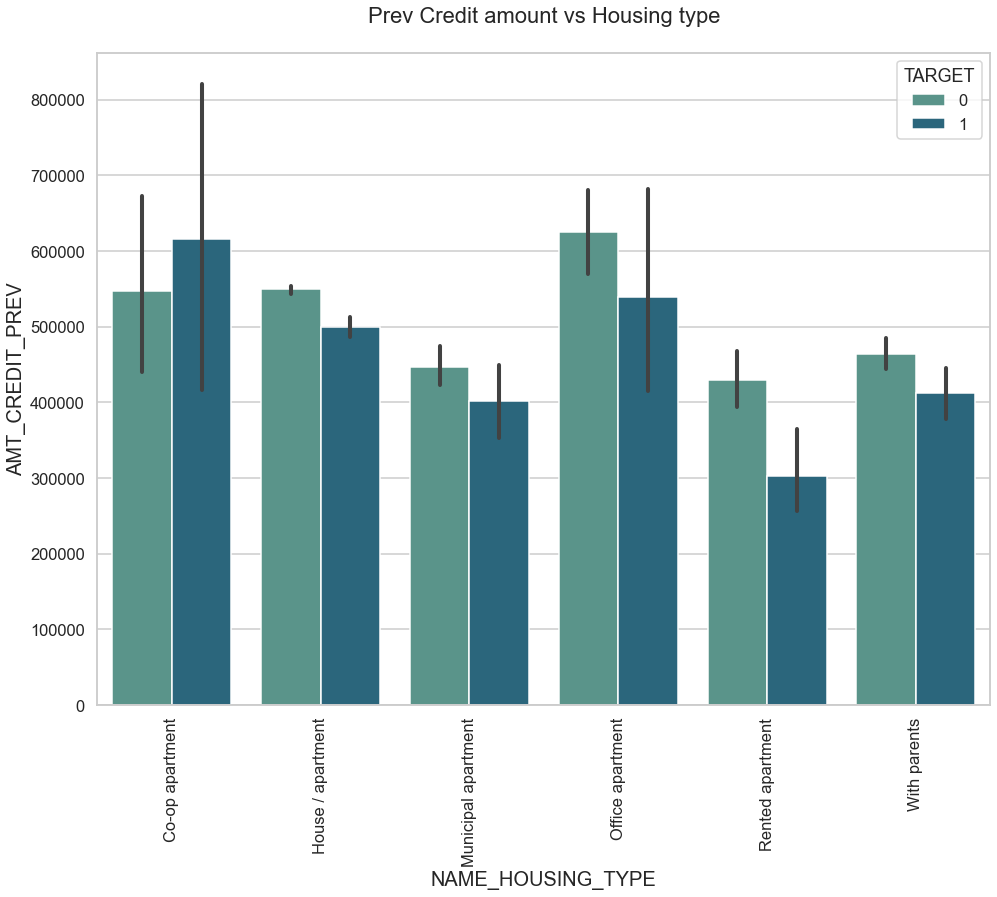

In [110]:
# Box plotting for Credit amount prev vs Housing type in logarithmic scale

plt.figure(figsize=(16,12))
plt.xticks(rotation=90)
sns.barplot(data =new_df1, y='AMT_CREDIT_PREV',hue='TARGET',x='NAME_HOUSING_TYPE', palette='crest')
plt.title('Prev Credit amount vs Housing type')
plt.show()

#### Points to be concluded
1. For Housing type, office apartment is having higher credit of target 0 and co-op apartment is having higher credit of target 
2. So, we can conclude that bank should avoid giving loans to the housing type of co-op apartment as they are having difficulties in payment. Bank can focus mostly on housing type with parents or House\apartment or municipal apartment for successful payments.

## CONCLUSION

1. Car ownership doesn't have any effect on application approval or rejection. But we did see earlier that the people who has a car has lesser chances of default. The bank can add more weightage to car ownership while approving a loan amount

2. Code gender doesn't have any effect on application approval or rejection. But we saw earlier that female have lesser chances of default compared to males. The bank can add more weightage to female while approving a loan amount.

3. We can see that the people who were approved for a loan earlier, defaulted less often where as people who were refused a loan earlier have higher chances of defaulting.

4. Banks should focus more on contract type ‘Student’ ,’pensioner’ and ‘Businessman’ with housing ‘type other than ‘Co-op apartment’ for successful payments.

5. Banks should focus less on income type ‘Working’ as they are having most number of unsuccessful payments.

6. Also with loan purpose ‘Repair’ is having higher number of unsuccessful payments on time.

7. Get as much as clients from housing type ‘With parents’ as they are having least number of unsuccessful payments.